In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Imports

In [2]:
import os
from typing import Optional, Tuple, List, Union, Callable

import numpy as np
import torch
from torch import nn
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
from tqdm import trange

# For repeatability
seed = 3407
torch.manual_seed(seed)
np.random.seed(seed)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Inputs

## Data

In [3]:
if not os.path.exists('/content/drive/MyDrive/Colab_Notebooks/Spin_Nerf/Nerf/tiny_nerf_data.npz'):
  !wget http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz

Images shape: (106, 100, 100, 3)
Poses shape: (106, 4, 4)
Focal length: 138.88887889922103
Pose
[[ 6.8935126e-01  5.3373039e-01 -4.8982298e-01 -1.9745398e+00]
 [-7.2442728e-01  5.0788772e-01 -4.6610624e-01 -1.8789345e+00]
 [ 1.4901163e-08  6.7615211e-01  7.3676193e-01  2.9699826e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]


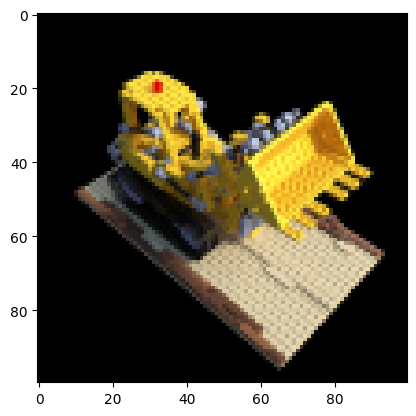

In [4]:
data = np.load('/content/drive/MyDrive/Colab_Notebooks/Spin_Nerf/Nerf/tiny_nerf_data.npz')
images = data['images']
poses = data['poses']
focal = data['focal']

print(f'Images shape: {images.shape}')
print(f'Poses shape: {poses.shape}')
print(f'Focal length: {focal}')

height, width = images.shape[1:3]
near, far = 2., 6.

n_training = 100
testimg_idx = 101
testimg, testpose = images[testimg_idx], poses[testimg_idx]

plt.imshow(testimg)
print('Pose')
print(testpose)

## Origins and Directions

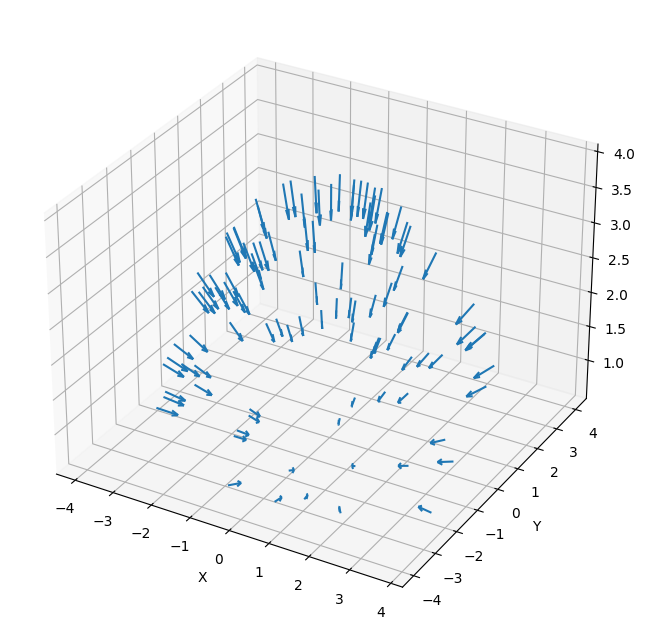

In [5]:
dirs = np.stack([np.sum([0, 0, -1] * pose[:3, :3], axis=-1) for pose in poses])
# get the origin of the camera frame
origins = poses[:, :3, -1]

# Plot the camera directions
ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
_ = ax.quiver(
  origins[..., 0],
  origins[..., 1],
  origins[..., 2],
  dirs[..., 0],
  dirs[..., 1],
  dirs[..., 2], length=0.5, normalize=True)

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('z')
plt.show()

In [6]:
def get_rays(
  height: int,
  width: int,
  focal_length: float,
  c2w: torch.Tensor
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Find origin and direction of rays through every pixel and camera origin.
  """

  # Apply pinhole camera model to gather directions at each pixel
  i, j = torch.meshgrid(
      torch.arange(width, dtype=torch.float32).to(c2w),
      torch.arange(height, dtype=torch.float32).to(c2w),
      indexing='ij')
  i, j = i.transpose(-1, -2), j.transpose(-1, -2)
  # i and j are now of shape [height, width]
  # i = [0, 1, 2, ..., width - 1] for every row
  # j = [0, 1, 2, ..., height - 1] for every column
  directions = torch.stack([(i - width * .5) / focal_length,
                            -(j - height * .5) / focal_length,
                            -torch.ones_like(i)
                           ], dim=-1)
  # directions is now of shape [height, width, 3] and contains the direction

  # Apply camera pose to directions
  rays_d = torch.sum(directions[..., None, :] * c2w[:3, :3], dim=-1)


  # Origin is same for all directions (the optical center)
  rays_o = c2w[:3, -1].expand(rays_d.shape)
  return rays_o, rays_d

In [7]:
i, j = torch.meshgrid(
      torch.arange(10, dtype=torch.float32).to(device='cpu'),
      torch.arange(10, dtype=torch.float32).to(device='cpu'),
      indexing='ij')
i, j = i.transpose(-1, -2), j.transpose(-1, -2)
directions = torch.stack([(i - 10 * .5) ,
                            -(j - 10 * .5) ,
                            -torch.ones_like(i)
                           ], dim=-1)
# testpose = torch.tensor([[ 1, 2, 3, 4],
#         [5,6,7,8],
#         [ 9,10,11,12],
#         [ 13,14,15,16]])
# rays_d = torch.sum(directions[..., None, :] * testpose[:3, :3], dim=-1)
print(-(j - 10 * .5))

tensor([[ 5.,  5.,  5.,  5.,  5.,  5.,  5.,  5.,  5.,  5.],
        [ 4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.],
        [ 3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.],
        [ 2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.],
        [ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.],
        [-0., -0., -0., -0., -0., -0., -0., -0., -0., -0.],
        [-1., -1., -1., -1., -1., -1., -1., -1., -1., -1.],
        [-2., -2., -2., -2., -2., -2., -2., -2., -2., -2.],
        [-3., -3., -3., -3., -3., -3., -3., -3., -3., -3.],
        [-4., -4., -4., -4., -4., -4., -4., -4., -4., -4.]])


In [9]:
# Gather as torch tensors
images = torch.from_numpy(data['images'][:n_training]).to(device)
poses = torch.from_numpy(data['poses']).to(device)
focal = torch.from_numpy(data['focal']).to(device)
testimg = torch.from_numpy(data['images'][testimg_idx]).to(device)
testpose = torch.from_numpy(data['poses'][testimg_idx]).to(device)

# Grab rays from sample image
height, width = images.shape[1:3]
with torch.no_grad():
  ray_origin, ray_direction = get_rays(height, width, focal, testpose)

print('Ray Origin')
print(ray_origin.shape)
print(ray_origin[height // 2, width // 2, :])
print('')

print('Ray Direction')
print(ray_direction.shape)
print(ray_direction[height // 2, width // 2, :])
print('')

Ray Origin
torch.Size([100, 100, 3])
tensor([-1.9745, -1.8789,  2.9700], device='cuda:0')

Ray Direction
torch.Size([100, 100, 3])
tensor([ 0.4898,  0.4661, -0.7368], device='cuda:0')



# Architecture

## Stratified Sampling

Now that we have these lines, defined as origin and direction vectors, we can begin the process of sampling them. Recall that NeRF takes a coarse-to-fine sampling strategy, starting with the stratified sampling approach.

The stratified sampling approach splits the ray into evenly-spaced bins and randomly samples within each bin. The `perturb` setting determines whether to sample points uniformly from each bin or to simply use the bin center as the point. In most cases, we want to keep `perturb = True` as it will encourage the network to learn over a continuously sampled space. It may be useful to disable for debugging.

In [10]:
def sample_stratified(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  n_samples: int,
  perturb: Optional[bool] = True,
  inverse_depth: bool = False
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Sample along ray from regularly-spaced bins.
  """

  # Grab samples for space integration along ray
  t_vals = torch.linspace(0., 1., n_samples, device=rays_o.device)
  if not inverse_depth:
    # Sample linearly between `near` and `far`
    z_vals = near * (1.-t_vals) + far * (t_vals)
  else:
    # Sample linearly in inverse depth (disparity)
    z_vals = 1./(1./near * (1.-t_vals) + 1./far * (t_vals))

  # Draw uniform samples from bins along ray
  if perturb:
    mids = .5 * (z_vals[1:] + z_vals[:-1])
    upper = torch.concat([mids, z_vals[-1:]], dim=-1)
    lower = torch.concat([z_vals[:1], mids], dim=-1)
    t_rand = torch.rand([n_samples], device=z_vals.device)
    z_vals = lower + (upper - lower) * t_rand
  z_vals = z_vals.expand(list(rays_o.shape[:-1]) + [n_samples])

  # Apply scale from `rays_d` and offset from `rays_o` to samples
  # pts: (width, height, n_samples, 3)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals[..., :, None]
  return pts, z_vals

In [11]:
# Draw stratified samples from example
rays_o = ray_origin.view([-1, 3])
rays_d = ray_direction.view([-1, 3])
n_samples = 8
perturb = True
inverse_depth = False
with torch.no_grad():
  pts, z_vals = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=perturb, inverse_depth=inverse_depth)
print('Input Points')
print(pts.shape)
print('')
print('Distances Along Ray')
print(z_vals.shape)

Input Points
torch.Size([10000, 8, 3])

Distances Along Ray
torch.Size([10000, 8])


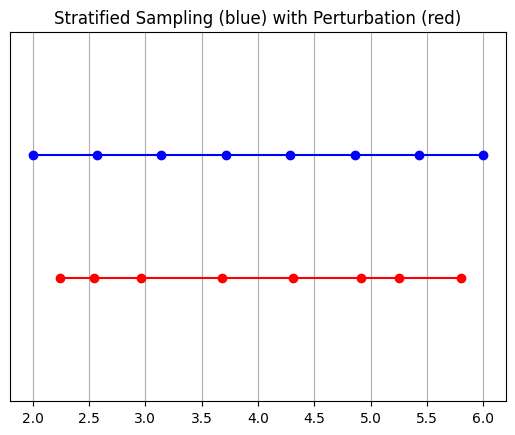

In [12]:
y_vals = torch.zeros_like(z_vals)

_, z_vals_unperturbed = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=False, inverse_depth=False)
plt.plot(z_vals_unperturbed[0].cpu().numpy(), 1 + y_vals[0].cpu().numpy(), 'b-o')
plt.plot(z_vals[0].cpu().numpy(), y_vals[0].cpu().numpy(), 'r-o')
plt.ylim([-1, 2])
plt.title('Stratified Sampling (blue) with Perturbation (red)')
ax = plt.gca()
ax.axes.yaxis.set_visible(False)
plt.grid(True)

## Positional Encoder

Much like Transformers, NeRFs make use of positional encoders. In this case, it's to map the inputs to a higher frequency space to compensate for the bias that neural networks have for learning lower-frequency functions.

Here we build a simple `torch.nn.Module` of our positional encoder. The same encoder implementation can be applied to both input samples and view directions. However, we choose different parameters for these inputs. We use the default settings from the original.

In [13]:
class PositionalEncoder(nn.Module):
    r"""
    Sine-cosine positional encoder for input points.
    """

    def __init__(
        self,
        d_input: int,
        n_freqs: int,
        log_space: bool = False
    ):
        super().__init__()
        self.d_input = d_input
        self.n_freqs = n_freqs
        self.log_space = log_space
        self.d_output = d_input * (1 + 2 * self.n_freqs)
        self.embed_fns = [lambda x: x]

        # Define frequencies in either linear or log scale
        if self.log_space:
            freq_bands = 2.**torch.linspace(0., self.n_freqs - 1, self.n_freqs)
        else:
            freq_bands = torch.linspace(
                2.**0., 2.**(self.n_freqs - 1), self.n_freqs)

        # Alternate sin and cos
        for freq in freq_bands:
            self.embed_fns.append(lambda x, freq=freq: torch.sin(x * freq))
            self.embed_fns.append(lambda x, freq=freq: torch.cos(x * freq))

    def forward(
        self,
        x
    ) -> torch.Tensor:
        r"""
        Apply positional encoding to input.
        """
        return torch.concat([fn(x) for fn in self.embed_fns], dim=-1)


In [14]:
encoder = PositionalEncoder(3, 10)
viewdirs_encoder = PositionalEncoder(3, 4)
# Grab flattened points and view directions
pts_flattened = pts.reshape(-1, 3)
viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
flattened_viewdirs = viewdirs[:, None, ...].expand(pts.shape).reshape((-1, 3))

# Encode inputs
encoded_points = encoder(pts_flattened)
encoded_viewdirs = viewdirs_encoder(flattened_viewdirs)

print('Encoded Points')
print(encoded_points.shape)
print(torch.min(encoded_points), torch.max(encoded_points), torch.mean(encoded_points))
print('')

print(encoded_viewdirs.shape)
print('Encoded Viewdirs')
print(torch.min(encoded_viewdirs), torch.max(encoded_viewdirs), torch.mean(encoded_viewdirs))
print('')

Encoded Points
torch.Size([80000, 63])
tensor(-2.6900, device='cuda:0') tensor(3.4005, device='cuda:0') tensor(0.0273, device='cuda:0')

torch.Size([80000, 27])
Encoded Viewdirs
tensor(-1., device='cuda:0') tensor(1., device='cuda:0') tensor(0.1056, device='cuda:0')



## NeRF Model

Here we define the NeRF model, which consists primarily of a `ModuleList` of `Linear` layers, separated by non-linear activation functions and the occasional residual connection. This model features an optional input for view directions, which will alter the model architecture if provided at instantiation. This implementation is based on Section 3 of the original "NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis" paper and uses the same defaults.

In [15]:
class NeRF(nn.Module):
  r"""
  Neural radiance fields module.
  """
  def __init__(
    self,
    d_input: int = 3,
    n_layers: int = 8,
    d_filter: int = 256,
    skip: Tuple[int] = (4,),
    d_viewdirs: Optional[int] = None
  ):
    super().__init__()
    self.d_input = d_input
    self.skip = skip
    self.act = nn.functional.relu
    self.d_viewdirs = d_viewdirs

    # Create model layers
    self.layers = nn.ModuleList(
      [nn.Linear(self.d_input, d_filter)] +
      [nn.Linear(d_filter + self.d_input, d_filter) if i in skip \
       else nn.Linear(d_filter, d_filter) for i in range(n_layers - 1)]
    )

    # Bottleneck layers
    if self.d_viewdirs is not None:
      # If using viewdirs, split alpha and RGB
      self.alpha_out = nn.Linear(d_filter, 1)
      self.rgb_filters = nn.Linear(d_filter, d_filter)
      self.branch = nn.Linear(d_filter + self.d_viewdirs, d_filter // 2)
      self.output = nn.Linear(d_filter // 2, 3)
    else:
      # If no viewdirs, use simpler output
      self.output = nn.Linear(d_filter, 4)

  def forward(
    self,
    x: torch.Tensor,
    viewdirs: Optional[torch.Tensor] = None
  ) -> torch.Tensor:
    r"""
    Forward pass with optional view direction.
    """

    # Cannot use viewdirs if instantiated with d_viewdirs = None
    if self.d_viewdirs is None and viewdirs is not None:
      raise ValueError('Cannot input x_direction if d_viewdirs was not given.')

    # Apply forward pass up to bottleneck
    x_input = x
    for i, layer in enumerate(self.layers):
      x = self.act(layer(x))
      if i in self.skip:
        x = torch.cat([x, x_input], dim=-1)

    # Apply bottleneck
    if self.d_viewdirs is not None:
      # Split alpha from network output
      alpha = self.alpha_out(x)

      # Pass through bottleneck to get RGB
      x = self.rgb_filters(x)
      x = torch.concat([x, viewdirs], dim=-1)
      x = self.act(self.branch(x))
      x = self.output(x)

      # Concatenate alphas to output
      x = torch.concat([x, alpha], dim=-1)
    else:
      # Simple output
      x = self.output(x)
    return x

## Volume Rendering

From the raw NeRF outputs, we still need to convert these into an image. This is where we apply the volume integration described in Equations 1-3 in Section 4 of the paper. Essentially, we take the weighted sum of all samples along the ray of each pixel to get the estimated color value at that pixel. Each RGB sample is weighted by its alpha value. Higher alpha values indicate higher likelihood that the sampled area is opaque, therefore points further along the ray are likelier to be occluded. The cumulative product ensures that those further points are dampened.

In [16]:
def cumprod_exclusive(
  tensor: torch.Tensor
) -> torch.Tensor:
  r"""
  (Courtesy of https://github.com/krrish94/nerf-pytorch)

  Mimick functionality of tf.math.cumprod(..., exclusive=True), as it isn't available in PyTorch.

  Args:
  tensor (torch.Tensor): Tensor whose cumprod (cumulative product, see `torch.cumprod`) along dim=-1
    is to be computed.
  Returns:
  cumprod (torch.Tensor): cumprod of Tensor along dim=-1, mimiciking the functionality of
    tf.math.cumprod(..., exclusive=True) (see `tf.math.cumprod` for details).
  """

  # Compute regular cumprod first (this is equivalent to `tf.math.cumprod(..., exclusive=False)`).
  # tf.math.cumprod([a, b, c])  # [a, a * b, a * b * c]
  cumprod = torch.cumprod(tensor, -1)
  # "Roll" the elements along dimension 'dim' by 1 element.
  cumprod = torch.roll(cumprod, 1, -1)
  # Replace the first element by "1" as this is what tf.cumprod(..., exclusive=True) does.
  # tf.math.cumprod([a, b, c], exclusive=True)  # [1, a, a * b]
  cumprod[..., 0] = 1.

  return cumprod

def raw2outputs(
  raw: torch.Tensor,
  z_vals: torch.Tensor,
  rays_d: torch.Tensor,
  raw_noise_std: float = 0.0,
  white_bkgd: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Convert the raw NeRF output into RGB and other maps.
  """

  # Difference between consecutive elements of `z_vals`. [n_rays, n_samples]
  dists = z_vals[..., 1:] - z_vals[..., :-1]
  dists = torch.cat([dists, 1e10 * torch.ones_like(dists[..., :1])], dim=-1)

  # Multiply each distance by the norm of its corresponding direction ray
  # to convert to real world distance (accounts for non-unit directions).
  dists = dists * torch.norm(rays_d[..., None, :], dim=-1)

  # Add noise to model's predictions for density. Can be used to
  # regularize network during training (prevents floater artifacts).
  noise = 0.
  if raw_noise_std > 0.:
    noise = torch.randn(raw[..., 3].shape) * raw_noise_std

  # Predict density of each sample along each ray. Higher values imply
  # higher likelihood of being absorbed at this point. [n_rays, n_samples]
  alpha = 1.0 - torch.exp(-nn.functional.relu(raw[..., 3] + noise) * dists)

  # Compute weight for RGB of each sample along each ray. [n_rays, n_samples]
  # The higher the alpha, the lower subsequent weights are driven.
  weights = alpha * cumprod_exclusive(1. - alpha + 1e-10)

  # Compute weighted RGB map.
  rgb = torch.sigmoid(raw[..., :3])  # [n_rays, n_samples, 3]
  rgb_map = torch.sum(weights[..., None] * rgb, dim=-2)  # [n_rays, 3]

  # Estimated depth map is predicted distance.
  depth_map = torch.sum(weights * z_vals, dim=-1)

  # Disparity map is inverse depth.
  # disp_map = 1. / torch.max(1e-10 * torch.ones_like(depth_map),
  #                           depth_map / torch.sum(weights, -1))

  # Sum of weights along each ray. In [0, 1] up to numerical error.
  acc_map = torch.sum(weights, dim=-1)

  # To composite onto a white background, use the accumulated alpha map.
  if white_bkgd:
    rgb_map = rgb_map + (1. - acc_map[..., None])

  return rgb_map, depth_map, acc_map, weights

## Hierarchical Volume Sampling

The 3D space is in fact very sparse with occlusions and so most points don't contribute much to the rendered image. It is therefore more beneficial to oversample regions with a high likelihood of contributing to the integral. Here we apply learned, normalized weights to the first set of samples to create a PDF across the ray, then apply inverse transform sampling to this PDF to gather a second set of samples.

In [17]:
def sample_pdf(
    bins: torch.Tensor,
    weights: torch.Tensor,
    n_samples: int,
    perturb: bool = False
) -> torch.Tensor:
    r"""
    Apply inverse transform sampling to a weighted set of points.
    """

    # Normalize weights to get PDF.
    pdf = (weights + 1e-5) / torch.sum(weights + 1e-5, -
                                       1, keepdims=True)  # [n_rays, weights.shape[-1]]

    # Convert PDF to CDF.
    cdf = torch.cumsum(pdf, dim=-1)  # [n_rays, weights.shape[-1]]
    # [n_rays, weights.shape[-1] + 1]
    cdf = torch.concat([torch.zeros_like(cdf[..., :1]), cdf], dim=-1)

    # Take sample positions to grab from CDF. Linear when perturb == 0.
    if not perturb:
        u = torch.linspace(0., 1., n_samples, device=cdf.device)
        u = u.expand(list(cdf.shape[:-1]) + [n_samples])  # [n_rays, n_samples]
    else:
        # [n_rays, n_samples]
        u = torch.rand(list(cdf.shape[:-1]) + [n_samples], device=cdf.device)

    # Find indices along CDF where values in u would be placed.
    u = u.contiguous()  # Returns contiguous tensor with same values.
    inds = torch.searchsorted(cdf, u, right=True)  # [n_rays, n_samples]

    # Clamp indices that are out of bounds.
    below = torch.clamp(inds - 1, min=0)
    above = torch.clamp(inds, max=cdf.shape[-1] - 1)
    inds_g = torch.stack([below, above], dim=-1)  # [n_rays, n_samples, 2]

    # Sample from cdf and the corresponding bin centers.
    matched_shape = list(inds_g.shape[:-1]) + [cdf.shape[-1]] # [n_rays, n_samples, cdf.shape[-1]]
    # [n_rays, n_samples, cdf.shape[-1]]
    cdf_g = torch.gather(cdf.unsqueeze(-2).expand(matched_shape), dim=-1,
                         index=inds_g)
    # [n_rays, n_samples, cdf.shape[-1]]
    bins_g = torch.gather(bins.unsqueeze(-2).expand(matched_shape), dim=-1,
                          index=inds_g)

    # Convert samples to ray length.
    denom = (cdf_g[..., 1] - cdf_g[..., 0])
    denom = torch.where(denom < 1e-5, torch.ones_like(denom), denom)
    t = (u - cdf_g[..., 0]) / denom
    samples = bins_g[..., 0] + t * (bins_g[..., 1] - bins_g[..., 0])

    return samples  # [n_rays, n_samples]

In [19]:
def sample_hierarchical(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  z_vals: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Apply hierarchical sampling to the rays.
  """

  # Draw samples from PDF using z_vals as bins and weights as probabilities.
  z_vals_mid = .5 * (z_vals[..., 1:] + z_vals[..., :-1])
  new_z_samples = sample_pdf(z_vals_mid, weights[..., 1:-1], n_samples,
                          perturb=perturb)
  new_z_samples = new_z_samples.detach()

  # Resample points from ray based on PDF.
  z_vals_combined, _ = torch.sort(torch.cat([z_vals, new_z_samples], dim=-1), dim=-1)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals_combined[..., :, None]  # [N_rays, N_samples + n_samples, 3]
  return pts, z_vals_combined, new_z_samples

## Full Forward Pass

In [20]:
def get_chunks(
  inputs: torch.Tensor,
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Divide an input into chunks.
  """
  return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

def prepare_chunks(
  points: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify points to prepare for NeRF model.
  """
  points = points.reshape((-1, 3))
  points = encoding_function(points)
  points = get_chunks(points, chunksize=chunksize)
  return points

def prepare_viewdirs_chunks(
  points: torch.Tensor,
  rays_d: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify viewdirs to prepare for NeRF model.
  """
  # Prepare the viewdirs
  viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
  viewdirs = viewdirs[:, None, ...].expand(points.shape).reshape((-1, 3))
  viewdirs = encoding_function(viewdirs)
  viewdirs = get_chunks(viewdirs, chunksize=chunksize)
  return viewdirs

In [21]:
def nerf_forward(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  encoding_fn: Callable[[torch.Tensor], torch.Tensor],
  coarse_model: nn.Module,
  kwargs_sample_stratified: dict = None,
  n_samples_hierarchical: int = 0,
  kwargs_sample_hierarchical: dict = None,
  fine_model = None,
  viewdirs_encoding_fn: Optional[Callable[[torch.Tensor], torch.Tensor]] = None,
  chunksize: int = 2**15
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, dict]:
  r"""
  Compute forward pass through model(s).
  """

  # Set no kwargs if none are given.
  if kwargs_sample_stratified is None:
    kwargs_sample_stratified = {}
  if kwargs_sample_hierarchical is None:
    kwargs_sample_hierarchical = {}

  # Sample query points along each ray.
  query_points, z_vals = sample_stratified(
      rays_o, rays_d, near, far, **kwargs_sample_stratified)

  # Prepare batches.
  batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
  if viewdirs_encoding_fn is not None:
    batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                               viewdirs_encoding_fn,
                                               chunksize=chunksize)
  else:
    batches_viewdirs = [None] * len(batches)

  # Coarse model pass.
  # Split the encoded points into "chunks", run the model on all chunks, and
  # concatenate the results (to avoid out-of-memory issues).
  predictions = []
  for batch, batch_viewdirs in zip(batches, batches_viewdirs):
    predictions.append(coarse_model(batch, viewdirs=batch_viewdirs))
  raw = torch.cat(predictions, dim=0)
  raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

  # Perform differentiable volume rendering to re-synthesize the RGB image.
  rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals, rays_d)
  # rgb_map, depth_map, acc_map, weights = render_volume_density(raw, rays_o, z_vals)
  outputs = {
      'z_vals_stratified': z_vals
  }

  # Fine model pass.
  if n_samples_hierarchical > 0:
    # Save previous outputs to return.
    rgb_map_0, depth_map_0, acc_map_0 = rgb_map, depth_map, acc_map

    # Apply hierarchical sampling for fine query points.
    query_points, z_vals_combined, z_hierarch = sample_hierarchical(
      rays_o, rays_d, z_vals, weights, n_samples_hierarchical,
      **kwargs_sample_hierarchical)

    # Prepare inputs as before.
    batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
    if viewdirs_encoding_fn is not None:
      batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                                 viewdirs_encoding_fn,
                                                 chunksize=chunksize)
    else:
      batches_viewdirs = [None] * len(batches)

    # Forward pass new samples through fine model.
    fine_model = fine_model if fine_model is not None else coarse_model
    predictions = []
    for batch, batch_viewdirs in zip(batches, batches_viewdirs):
      predictions.append(fine_model(batch, viewdirs=batch_viewdirs))
    raw = torch.cat(predictions, dim=0)
    raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

    # Perform differentiable volume rendering to re-synthesize the RGB image.
    rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals_combined, rays_d)

    # Store outputs.
    outputs['z_vals_hierarchical'] = z_hierarch
    outputs['rgb_map_0'] = rgb_map_0
    outputs['depth_map_0'] = depth_map_0
    outputs['acc_map_0'] = acc_map_0

  # Store outputs.
  outputs['rgb_map'] = rgb_map
  outputs['depth_map'] = depth_map
  outputs['acc_map'] = acc_map
  outputs['weights'] = weights
  return outputs

# Train

At long last, we have (almost) everything we need to train the model. Now we will do some setup for a simple training procedure, creating hyperparameters and helper functions, then train our model.

## Hyperparameters

All hyperparameters for training are set here. Defaults were taken from the original, unless computational constraints prohibit them. In this case, we apply sensible defaults that are well within the resources provided by Google Colab.

In [22]:
# Encoders
d_input = 3           # Number of input dimensions
n_freqs = 10          # Number of encoding functions for samples
log_space = True      # If set, frequencies scale in log space
use_viewdirs = True   # If set, use view direction as input
n_freqs_views = 4     # Number of encoding functions for views

# Stratified sampling
n_samples = 64         # Number of spatial samples per ray
perturb = True         # If set, applies noise to sample positions
inverse_depth = False  # If set, samples points linearly in inverse depth

# Model
d_filter = 128          # Dimensions of linear layer filters
n_layers = 2            # Number of layers in network bottleneck
skip = []               # Layers at which to apply input residual
use_fine_model = True   # If set, creates a fine model
d_filter_fine = 128     # Dimensions of linear layer filters of fine network
n_layers_fine = 6       # Number of layers in fine network bottleneck

# Hierarchical sampling
n_samples_hierarchical = 64   # Number of samples per ray
perturb_hierarchical = False  # If set, applies noise to sample positions

# Optimizer
lr = 5e-4  # Learning rate

# Training
n_iters = 5000
batch_size = 2**14          # Number of rays per gradient step (power of 2)
one_image_per_step = True   # One image per gradient step (disables batching)
chunksize = 2**14           # Modify as needed to fit in GPU memory
center_crop = True          # Crop the center of image (one_image_per_)
center_crop_iters = 50      # Stop cropping center after this many epochs
display_rate = 25          # Display test output every X epochs

# Early Stopping
warmup_iters = 100          # Number of iterations during warmup phase
warmup_min_fitness = 10.0   # Min val PSNR to continue training at warmup_iters
n_restarts = 10             # Number of times to restart if training stalls

# We bundle the kwargs for various functions to pass all at once.
kwargs_sample_stratified = {
    'n_samples': n_samples,
    'perturb': perturb,
    'inverse_depth': inverse_depth
}
kwargs_sample_hierarchical = {
    'perturb': perturb
}

## Training Classes and Functions

Here we create some helper functions for training. NeRF can be prone to local minima, in which training will quickly stall and produce blank outputs. `EarlyStopping` is used to restart the training when learning stalls, if necessary.

In [23]:
def plot_samples(
  z_vals: torch.Tensor,
  z_hierarch: Optional[torch.Tensor] = None,
  ax: Optional[np.ndarray] = None):
  r"""
  Plot stratified and (optional) hierarchical samples.
  """
  y_vals = 1 + np.zeros_like(z_vals)

  if ax is None:
    ax = plt.subplot()
  ax.plot(z_vals, y_vals, 'b-o')
  if z_hierarch is not None:
    y_hierarch = np.zeros_like(z_hierarch)
    ax.plot(z_hierarch, y_hierarch, 'r-o')
  ax.set_ylim([-1, 2])
  ax.set_title('Stratified  Samples (blue) and Hierarchical Samples (red)')
  ax.axes.yaxis.set_visible(False)
  ax.grid(True)
  return ax

def crop_center(
  img: torch.Tensor,
  frac: float = 0.5
) -> torch.Tensor:
  r"""
  Crop center square from image.
  """
  h_offset = round(img.shape[0] * (frac / 2))
  w_offset = round(img.shape[1] * (frac / 2))
  return img[h_offset:-h_offset, w_offset:-w_offset]

class EarlyStopping:
  r"""
  Early stopping helper based on fitness criterion.
  """
  def __init__(
    self,
    patience: int = 30,
    margin: float = 1e-4
  ):
    self.best_fitness = 0.0  # In our case PSNR
    self.best_iter = 0
    self.margin = margin
    self.patience = patience or float('inf')  # epochs to wait after fitness stops improving to stop

  def __call__(
    self,
    iter: int,
    fitness: float
  ):
    r"""
    Check if criterion for stopping is met.
    """
    if (fitness - self.best_fitness) > self.margin:
      self.best_iter = iter
      self.best_fitness = fitness
    delta = iter - self.best_iter
    stop = delta >= self.patience  # stop training if patience exceeded
    return stop

In [24]:
def init_models():
  r"""
  Initialize models, encoders, and optimizer for NeRF training.
  """
  # Encoders
  encoder = PositionalEncoder(d_input, n_freqs, log_space=log_space)
  encode = lambda x: encoder(x)

  # View direction encoders
  if use_viewdirs:
    encoder_viewdirs = PositionalEncoder(d_input, n_freqs_views,
                                        log_space=log_space)
    encode_viewdirs = lambda x: encoder_viewdirs(x)
    d_viewdirs = encoder_viewdirs.d_output
  else:
    encode_viewdirs = None
    d_viewdirs = None

  # Models
  model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
              d_viewdirs=d_viewdirs)
  model.to(device)
  model_params = list(model.parameters())
  if use_fine_model:
    fine_model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
                      d_viewdirs=d_viewdirs)
    fine_model.to(device)
    model_params = model_params + list(fine_model.parameters())
  else:
    fine_model = None

  # Optimizer
  optimizer = torch.optim.Adam(model_params, lr=lr)

  # Early Stopping
  warmup_stopper = EarlyStopping(patience=50)

  return model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper

## Training Loop

Here we start training our model.

In [25]:
def train():
  r"""
  Launch training session for NeRF.
  """
  # Shuffle rays across all images.
  if not one_image_per_step:
    height, width = images.shape[1:3]
    all_rays = torch.stack([torch.stack(get_rays(height, width, focal, p), 0)
                        for p in poses[:n_training]], 0)
    rays_rgb = torch.cat([all_rays, images[:, None]], 1)
    rays_rgb = torch.permute(rays_rgb, [0, 2, 3, 1, 4])
    rays_rgb = rays_rgb.reshape([-1, 3, 3])
    rays_rgb = rays_rgb.type(torch.float32)
    rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
    i_batch = 0

  train_psnrs = []
  val_psnrs = []
  iternums = []
  for i in trange(n_iters):
    model.train()

    if one_image_per_step:
      # Randomly pick an image as the target.
      target_img_idx = np.random.randint(images.shape[0])
      target_img = images[target_img_idx].to(device)
      if center_crop and i < center_crop_iters:
        target_img = crop_center(target_img)
      height, width = target_img.shape[:2]
      target_pose = poses[target_img_idx].to(device)
      rays_o, rays_d = get_rays(height, width, focal, target_pose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
    else:
      # Random over all images.
      batch = rays_rgb[i_batch:i_batch + batch_size]
      batch = torch.transpose(batch, 0, 1)
      rays_o, rays_d, target_img = batch
      height, width = target_img.shape[:2]
      i_batch += batch_size
      # Shuffle after one epoch
      if i_batch >= rays_rgb.shape[0]:
          rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
          i_batch = 0
    target_img = target_img.reshape([-1, 3])

    # Run one iteration of TinyNeRF and get the rendered RGB image.
    outputs = nerf_forward(rays_o, rays_d,
                           near, far, encode, model,
                           kwargs_sample_stratified=kwargs_sample_stratified,
                           n_samples_hierarchical=n_samples_hierarchical,
                           kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                           fine_model=fine_model,
                           viewdirs_encoding_fn=encode_viewdirs,
                           chunksize=chunksize)

    # Check for any numerical issues.
    for k, v in outputs.items():
      if torch.isnan(v).any():
        print(f"! [Numerical Alert] {k} contains NaN.")
      if torch.isinf(v).any():
        print(f"! [Numerical Alert] {k} contains Inf.")

    # Backprop!
    rgb_predicted = outputs['rgb_map']
    loss = torch.nn.functional.mse_loss(rgb_predicted, target_img)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()
    psnr = -10. * torch.log10(loss)
    train_psnrs.append(psnr.item())

    # Evaluate testimg at given display rate.
    if i % display_rate == 0:
      model.eval()
      height, width = testimg.shape[:2]
      rays_o, rays_d = get_rays(height, width, focal, testpose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
      outputs = nerf_forward(rays_o, rays_d,
                             near, far, encode, model,
                             kwargs_sample_stratified=kwargs_sample_stratified,
                             n_samples_hierarchical=n_samples_hierarchical,
                             kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                             fine_model=fine_model,
                             viewdirs_encoding_fn=encode_viewdirs,
                             chunksize=chunksize)

      rgb_predicted = outputs['rgb_map']
      loss = torch.nn.functional.mse_loss(rgb_predicted, testimg.reshape(-1, 3))
      print("Loss:", loss.item())
      val_psnr = -10. * torch.log10(loss)
      val_psnrs.append(val_psnr.item())
      iternums.append(i)

      # Plot example outputs
      fig, ax = plt.subplots(1, 4, figsize=(24,4), gridspec_kw={'width_ratios': [1, 1, 1, 3]})
      ax[0].imshow(rgb_predicted.reshape([height, width, 3]).detach().cpu().numpy())
      ax[0].set_title(f'Iteration: {i}')
      ax[1].imshow(testimg.detach().cpu().numpy())
      ax[1].set_title(f'Target')
      ax[2].plot(range(0, i + 1), train_psnrs, 'r')
      ax[2].plot(iternums, val_psnrs, 'b')
      ax[2].set_title('PSNR (train=red, val=blue')
      z_vals_strat = outputs['z_vals_stratified'].view((-1, n_samples))
      z_sample_strat = z_vals_strat[z_vals_strat.shape[0] // 2].detach().cpu().numpy()
      if 'z_vals_hierarchical' in outputs:
        z_vals_hierarch = outputs['z_vals_hierarchical'].view((-1, n_samples_hierarchical))
        z_sample_hierarch = z_vals_hierarch[z_vals_hierarch.shape[0] // 2].detach().cpu().numpy()
      else:
        z_sample_hierarch = None
      _ = plot_samples(z_sample_strat, z_sample_hierarch, ax=ax[3])
      ax[3].margins(0)
      plt.show()

    # Check PSNR for issues and stop if any are found.
    if i == warmup_iters - 1:
      if val_psnr < warmup_min_fitness:
        print(f'Val PSNR {val_psnr} below warmup_min_fitness {warmup_min_fitness}. Stopping...')
        return False, train_psnrs, val_psnrs
    elif i < warmup_iters:
      if warmup_stopper is not None and warmup_stopper(i, psnr):
        print(f'Train PSNR flatlined at {psnr} for {warmup_stopper.patience} iters. Stopping...')
        return False, train_psnrs, val_psnrs

  return True, train_psnrs, val_psnrs

  0%|          | 0/5000 [00:00<?, ?it/s]

Loss: 0.12420696765184402


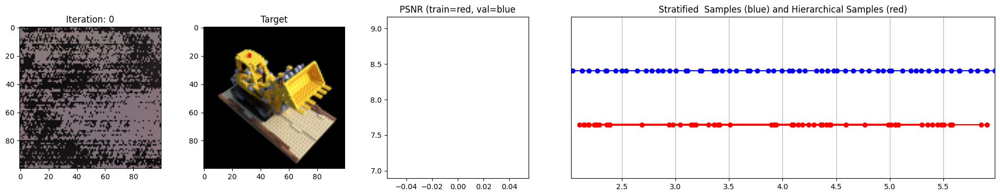

  0%|          | 24/5000 [00:04<08:23,  9.88it/s]

Loss: 0.10826098918914795


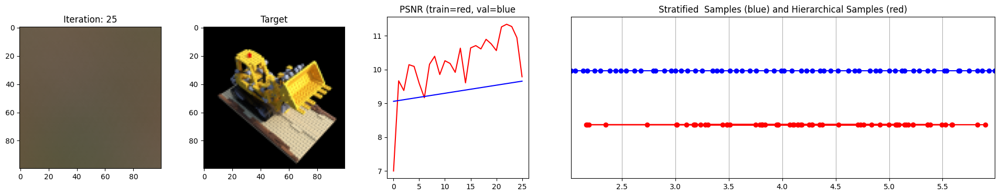

  1%|          | 49/5000 [00:07<08:13, 10.04it/s]

Loss: 0.10015063732862473


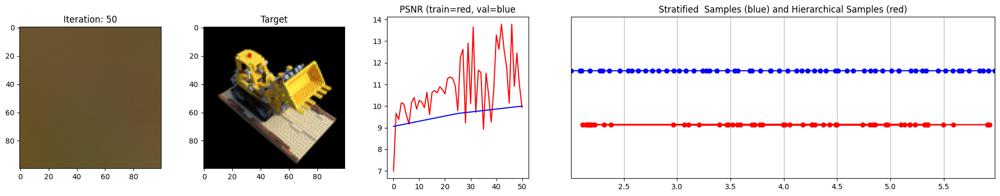

  2%|▏         | 75/5000 [00:19<34:17,  2.39it/s]

Loss: 0.08695994317531586


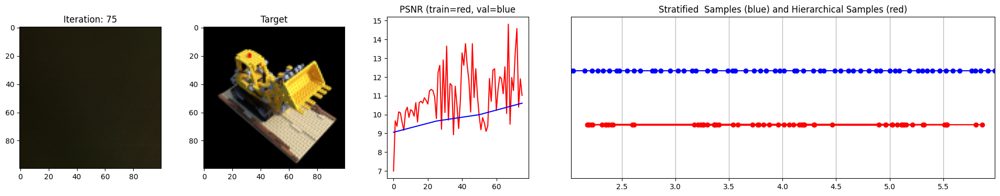

  2%|▏         | 100/5000 [00:30<34:23,  2.37it/s]

Loss: 0.08007804304361343


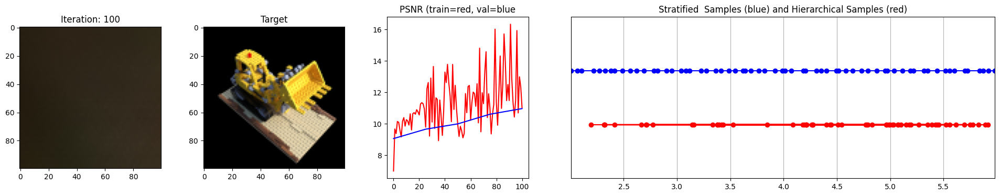

  2%|▎         | 125/5000 [00:42<34:22,  2.36it/s]

Loss: 0.07971401512622833


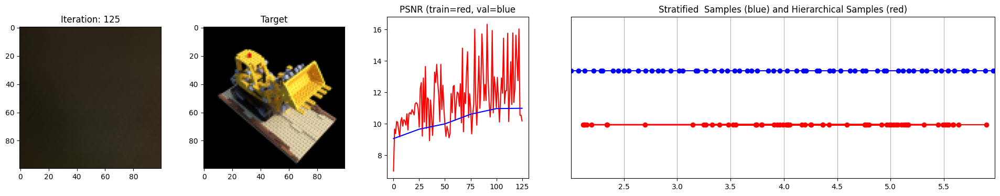

  3%|▎         | 150/5000 [00:54<34:23,  2.35it/s]

Loss: 0.07741563767194748


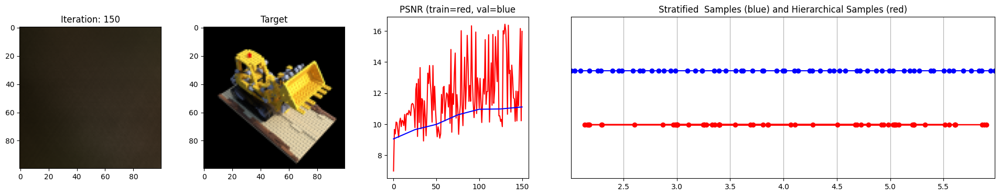

  4%|▎         | 175/5000 [01:05<34:15,  2.35it/s]

Loss: 0.07442989945411682


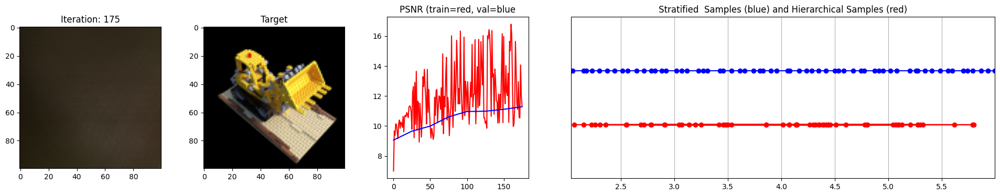

  4%|▍         | 200/5000 [01:17<34:24,  2.32it/s]

Loss: 0.07013368606567383


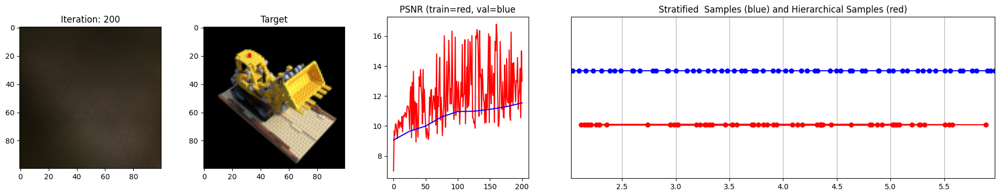

  4%|▍         | 225/5000 [01:29<34:42,  2.29it/s]

Loss: 0.06254404038190842


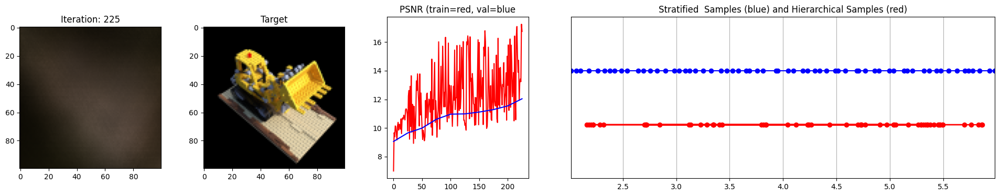

  5%|▌         | 250/5000 [01:41<34:19,  2.31it/s]

Loss: 0.05304006114602089


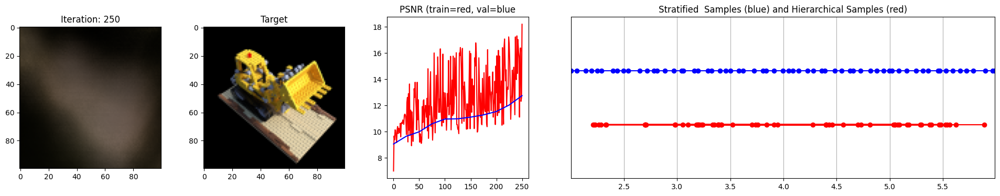

  6%|▌         | 275/5000 [01:53<34:03,  2.31it/s]

Loss: 0.03995617479085922


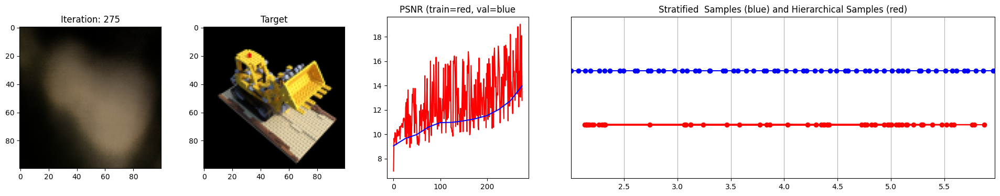

  6%|▌         | 300/5000 [02:05<33:42,  2.32it/s]

Loss: 0.03452037647366524


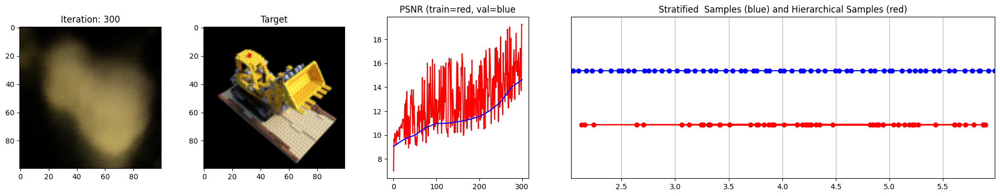

  6%|▋         | 325/5000 [02:17<33:36,  2.32it/s]

Loss: 0.031149031594395638


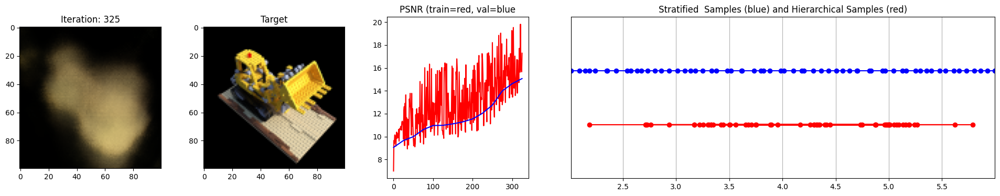

  7%|▋         | 350/5000 [02:29<33:16,  2.33it/s]

Loss: 0.02628960646688938


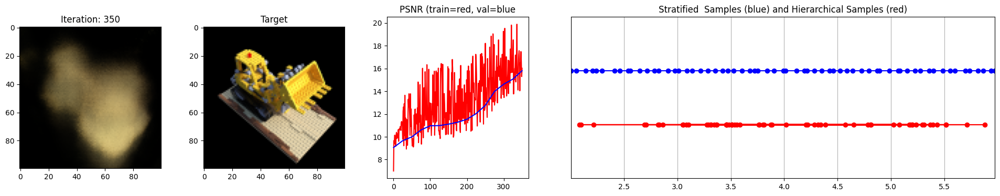

  8%|▊         | 375/5000 [02:41<33:10,  2.32it/s]

Loss: 0.025520717725157738


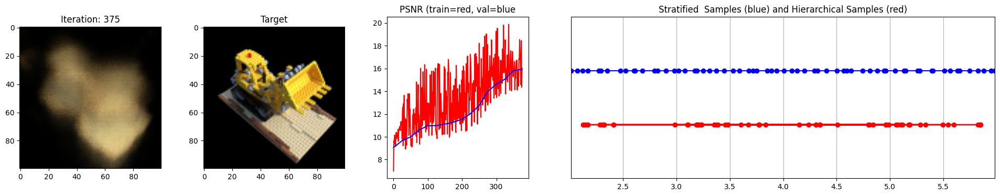

  8%|▊         | 400/5000 [02:53<33:04,  2.32it/s]

Loss: 0.02396896481513977


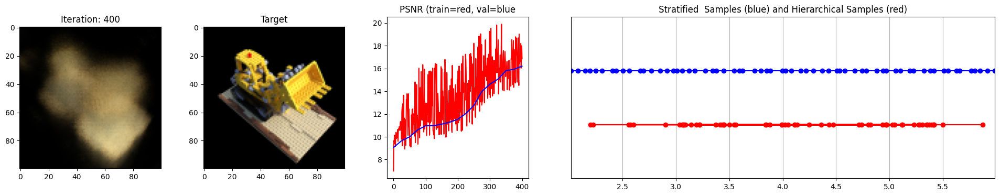

  8%|▊         | 425/5000 [03:05<32:53,  2.32it/s]

Loss: 0.02351073920726776


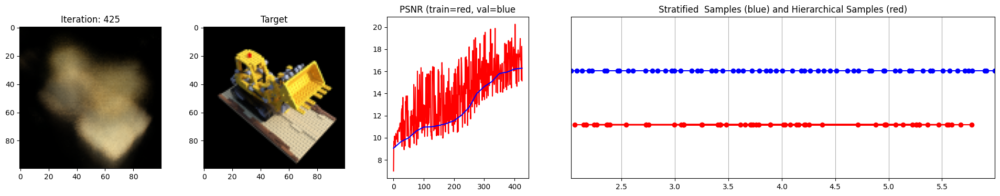

  9%|▉         | 450/5000 [03:16<32:49,  2.31it/s]

Loss: 0.021370161324739456


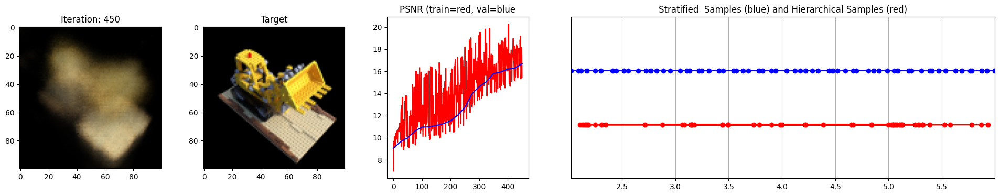

 10%|▉         | 475/5000 [03:28<32:23,  2.33it/s]

Loss: 0.023158317431807518


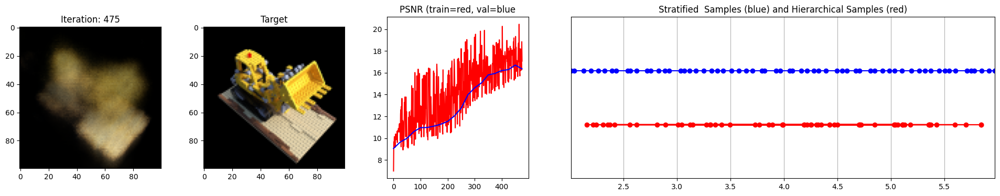

 10%|█         | 500/5000 [03:40<32:08,  2.33it/s]

Loss: 0.020669521763920784


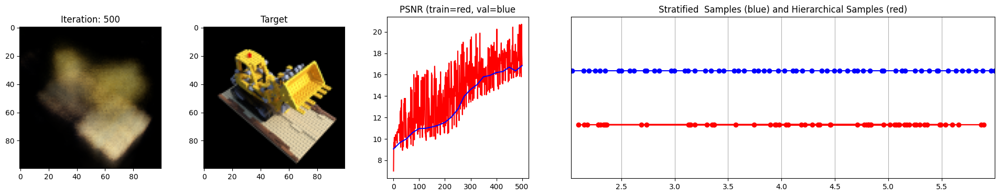

 10%|█         | 525/5000 [03:52<32:00,  2.33it/s]

Loss: 0.018814416602253914


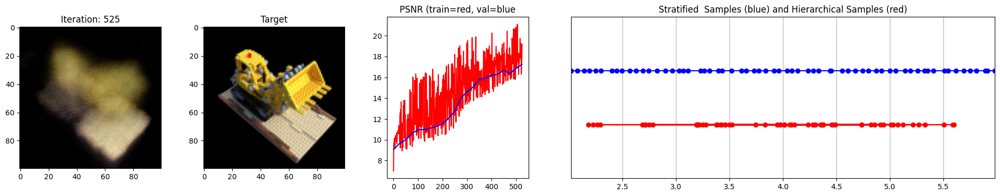

 11%|█         | 550/5000 [04:03<31:53,  2.33it/s]

Loss: 0.017733100801706314


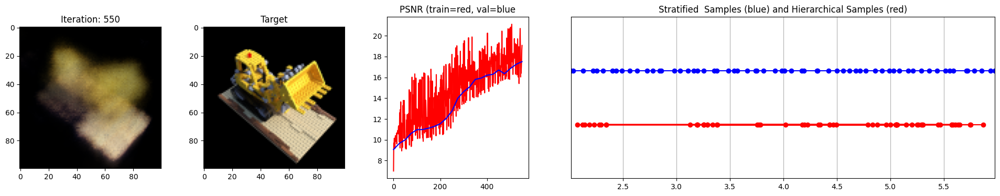

 12%|█▏        | 575/5000 [04:15<31:46,  2.32it/s]

Loss: 0.01770094595849514


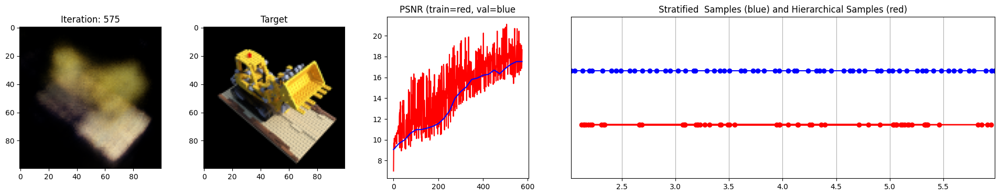

 12%|█▏        | 600/5000 [04:27<31:19,  2.34it/s]

Loss: 0.01755293644964695


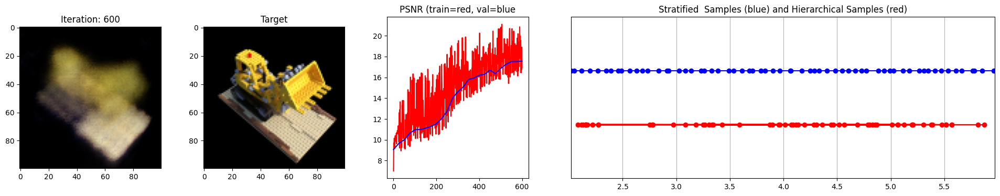

 12%|█▎        | 625/5000 [04:39<31:17,  2.33it/s]

Loss: 0.018020156770944595


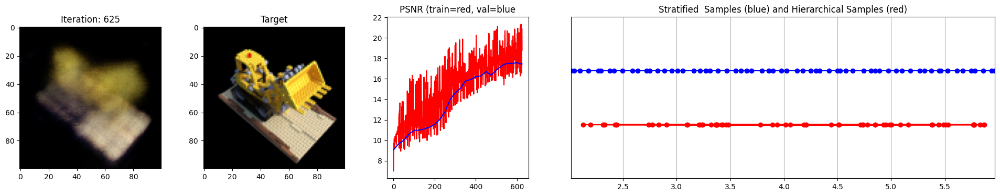

 13%|█▎        | 650/5000 [04:51<31:08,  2.33it/s]

Loss: 0.016184033825993538


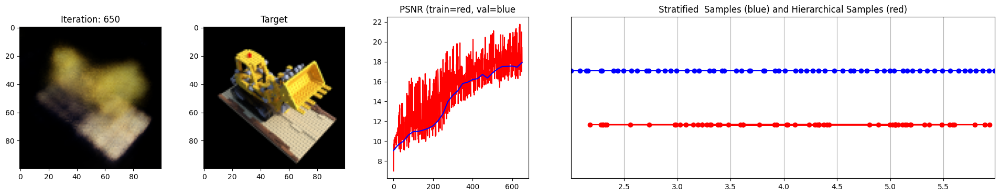

 14%|█▎        | 675/5000 [05:03<31:04,  2.32it/s]

Loss: 0.015726270154118538


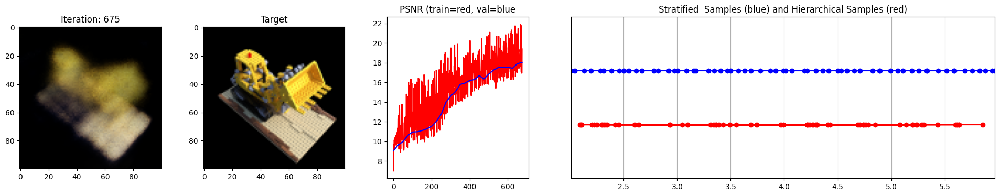

 14%|█▍        | 700/5000 [05:14<30:46,  2.33it/s]

Loss: 0.015613646246492863


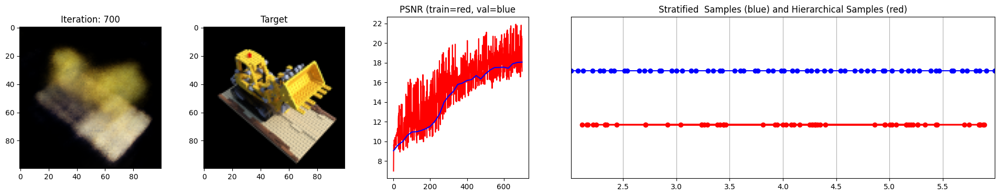

 14%|█▍        | 725/5000 [05:26<30:32,  2.33it/s]

Loss: 0.014858538284897804


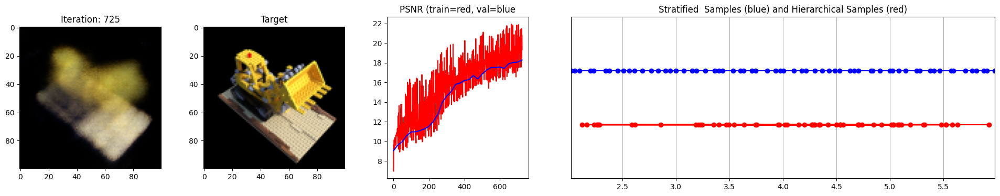

 15%|█▌        | 750/5000 [05:38<30:20,  2.33it/s]

Loss: 0.014442293904721737


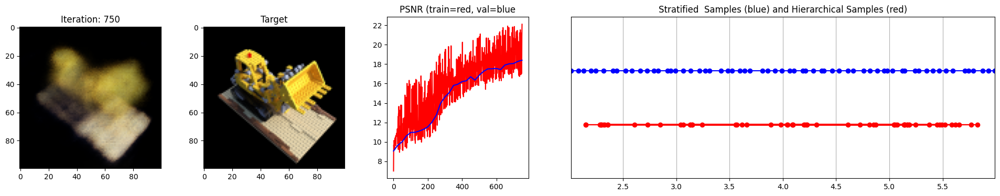

 16%|█▌        | 775/5000 [05:50<30:21,  2.32it/s]

Loss: 0.014002498239278793


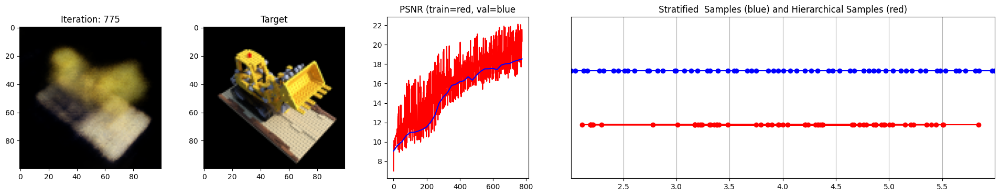

 16%|█▌        | 800/5000 [06:02<29:58,  2.34it/s]

Loss: 0.016798686236143112


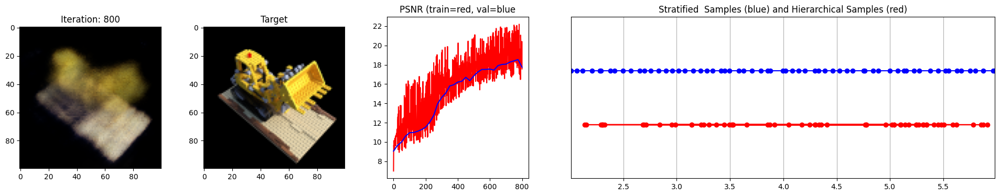

 16%|█▋        | 825/5000 [06:14<29:46,  2.34it/s]

Loss: 0.01471590157598257


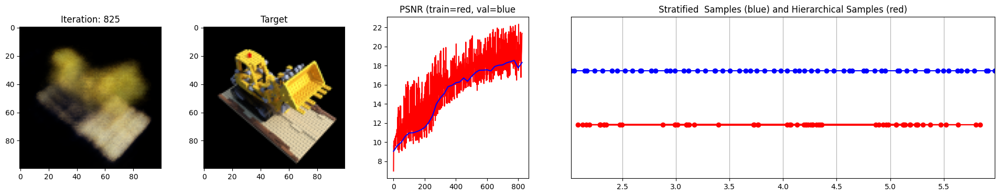

 17%|█▋        | 850/5000 [06:26<29:32,  2.34it/s]

Loss: 0.013647177256643772


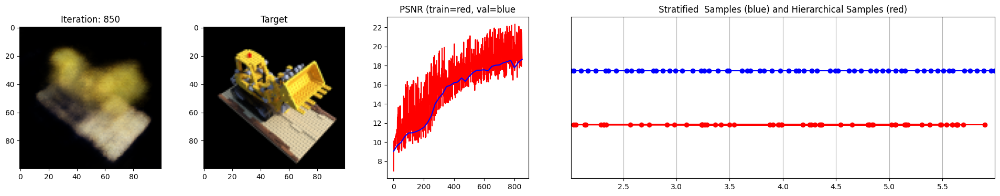

 18%|█▊        | 875/5000 [06:37<29:34,  2.32it/s]

Loss: 0.013762811198830605


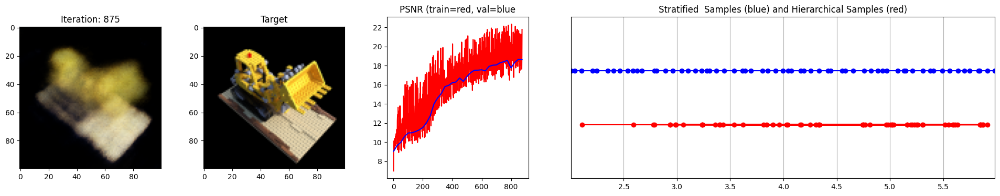

 18%|█▊        | 900/5000 [06:49<29:12,  2.34it/s]

Loss: 0.014248913154006004


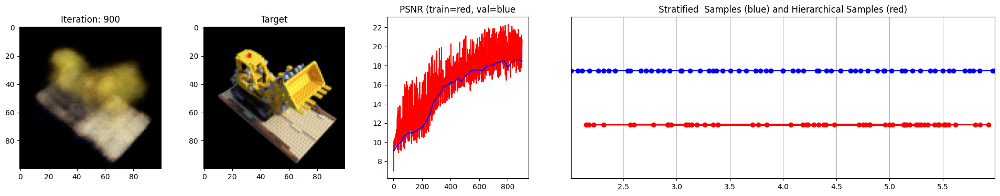

 18%|█▊        | 925/5000 [07:01<29:04,  2.34it/s]

Loss: 0.01378710474818945


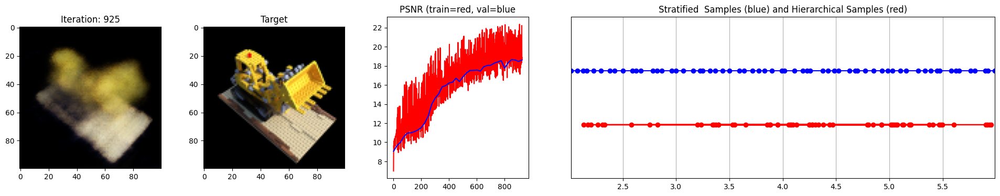

 19%|█▉        | 950/5000 [07:13<28:48,  2.34it/s]

Loss: 0.01296066865324974


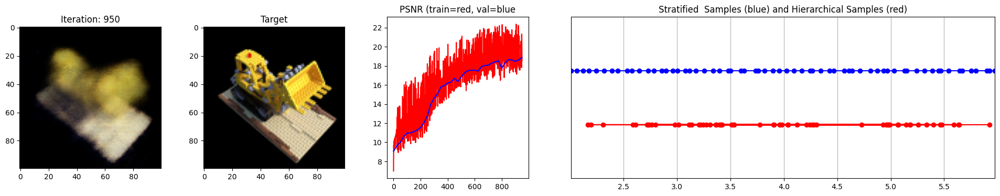

 20%|█▉        | 975/5000 [07:25<28:55,  2.32it/s]

Loss: 0.013257852755486965


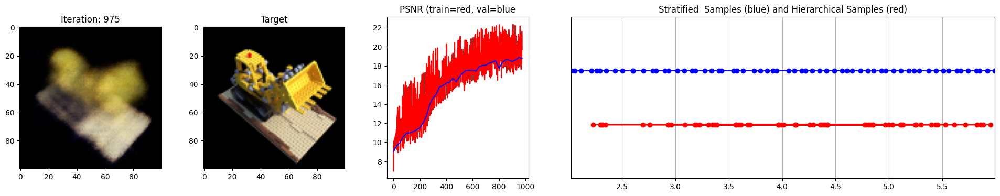

 20%|██        | 1000/5000 [07:36<28:40,  2.32it/s]

Loss: 0.011738527566194534


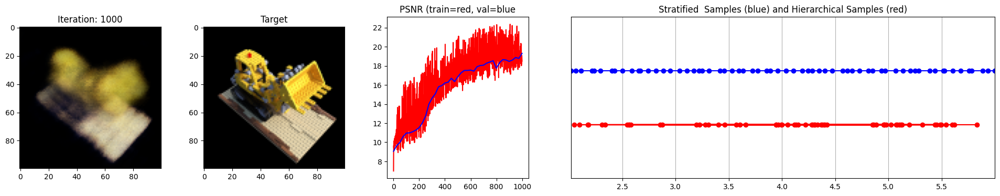

 20%|██        | 1025/5000 [07:48<28:20,  2.34it/s]

Loss: 0.012064683251082897


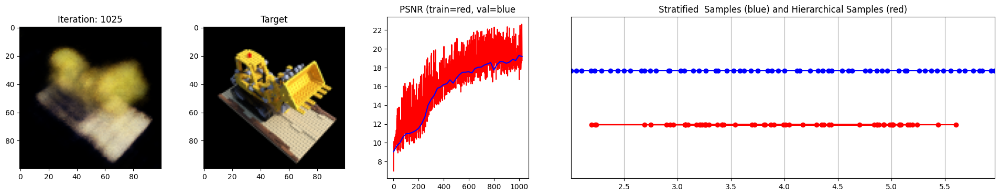

 21%|██        | 1050/5000 [08:00<28:06,  2.34it/s]

Loss: 0.0117411557585001


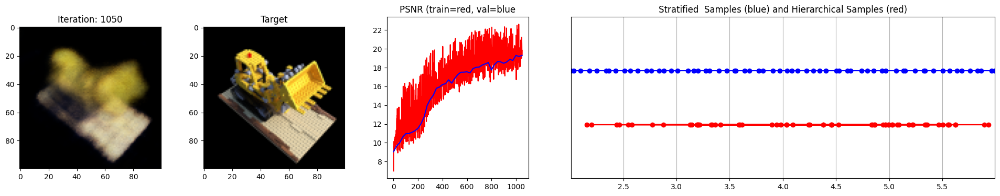

 22%|██▏       | 1075/5000 [08:12<28:12,  2.32it/s]

Loss: 0.012731927447021008


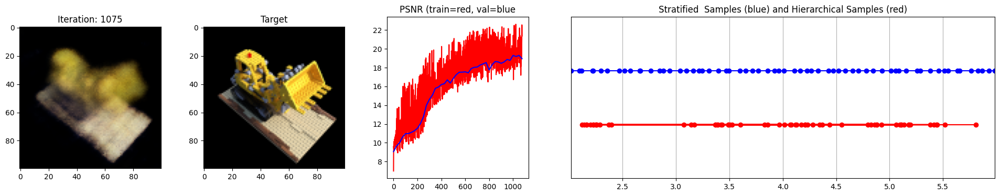

 22%|██▏       | 1100/5000 [08:24<27:49,  2.34it/s]

Loss: 0.011260048486292362


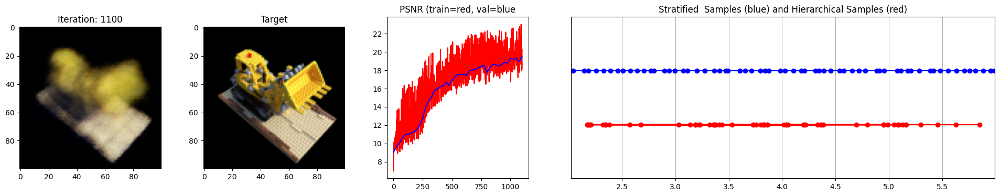

 22%|██▎       | 1125/5000 [08:36<27:33,  2.34it/s]

Loss: 0.012089214287698269


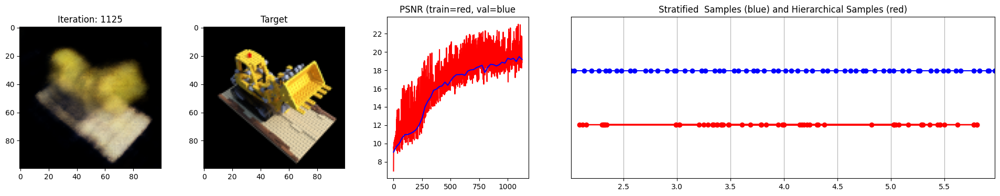

 23%|██▎       | 1150/5000 [08:48<27:33,  2.33it/s]

Loss: 0.012476852163672447


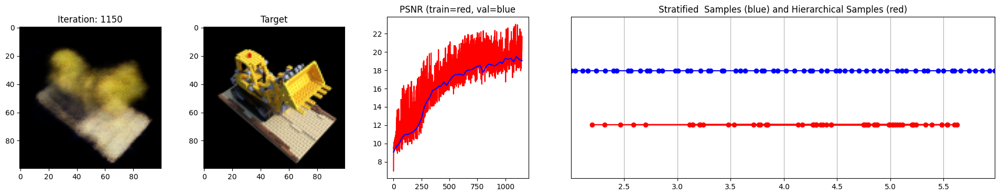

 24%|██▎       | 1175/5000 [08:59<27:21,  2.33it/s]

Loss: 0.012364151887595654


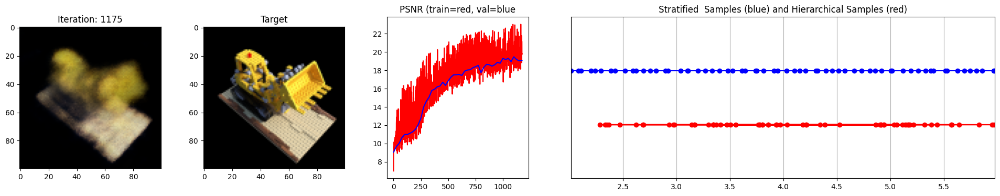

 24%|██▍       | 1200/5000 [09:11<27:01,  2.34it/s]

Loss: 0.012797132134437561


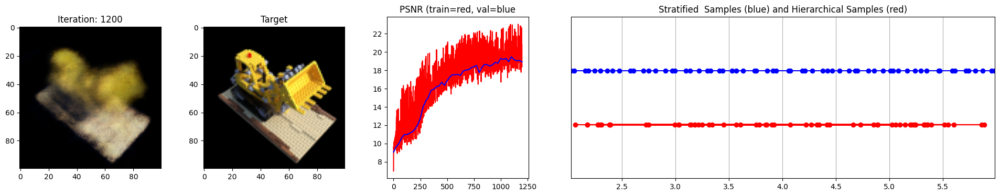

 24%|██▍       | 1225/5000 [09:23<26:54,  2.34it/s]

Loss: 0.012585915625095367


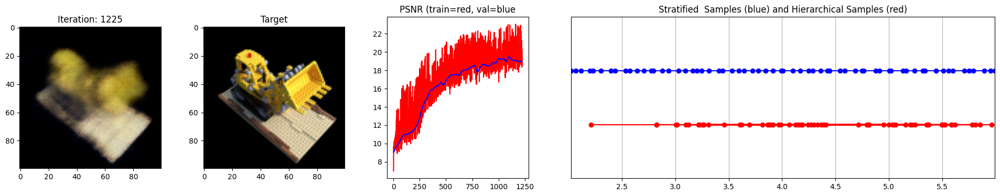

 25%|██▌       | 1250/5000 [09:35<26:52,  2.33it/s]

Loss: 0.011637215502560139


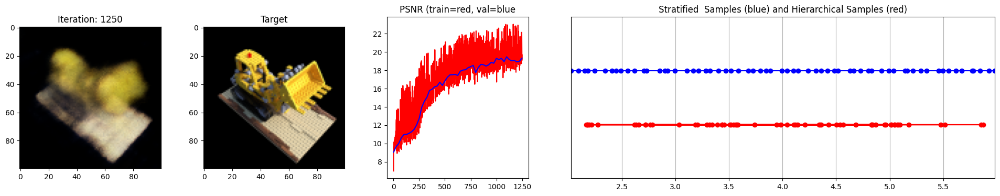

 26%|██▌       | 1275/5000 [09:47<26:37,  2.33it/s]

Loss: 0.01134658232331276


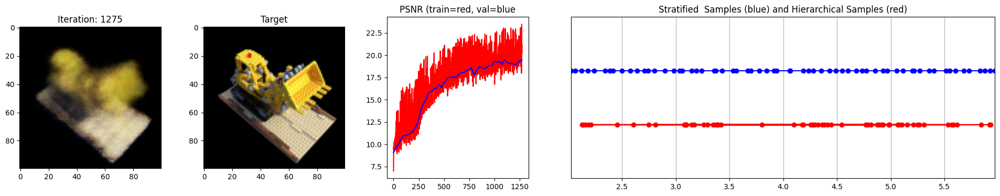

 26%|██▌       | 1300/5000 [09:59<26:20,  2.34it/s]

Loss: 0.011268050409853458


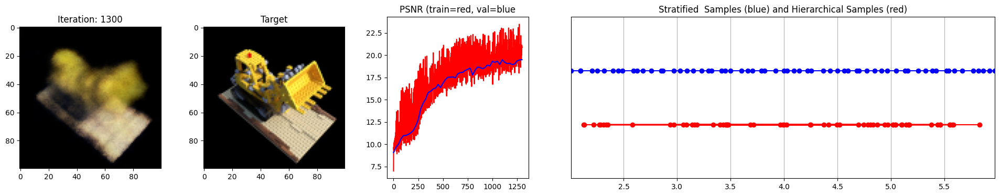

 26%|██▋       | 1325/5000 [10:10<26:18,  2.33it/s]

Loss: 0.010919690132141113


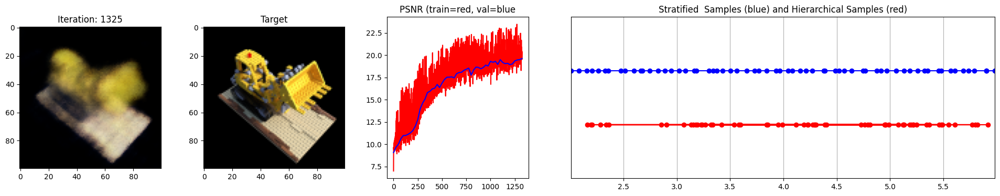

 27%|██▋       | 1350/5000 [10:22<26:06,  2.33it/s]

Loss: 0.01162188220769167


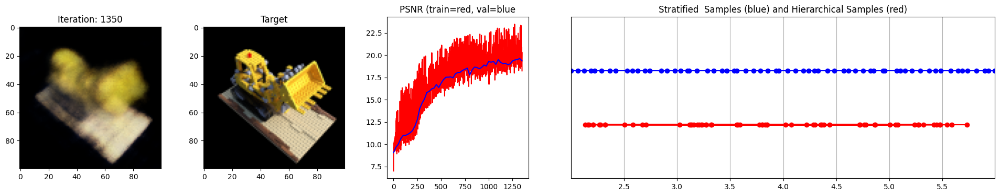

 28%|██▊       | 1375/5000 [10:34<25:48,  2.34it/s]

Loss: 0.012122794054448605


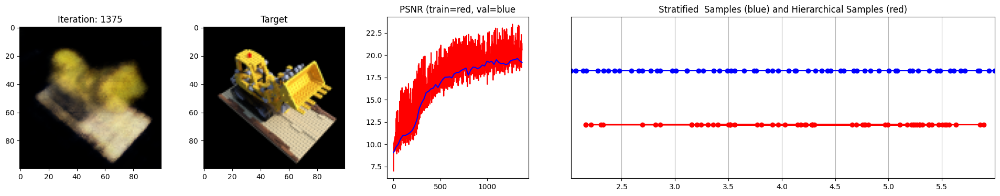

 28%|██▊       | 1400/5000 [10:46<25:36,  2.34it/s]

Loss: 0.010891016572713852


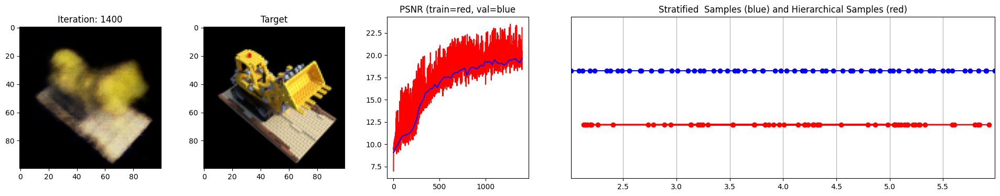

 28%|██▊       | 1425/5000 [10:58<25:39,  2.32it/s]

Loss: 0.011076431721448898


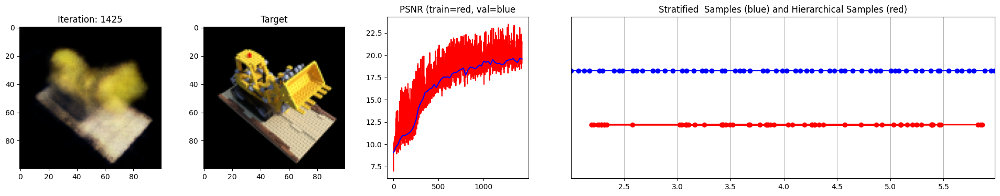

 29%|██▉       | 1450/5000 [11:10<25:16,  2.34it/s]

Loss: 0.010511299595236778


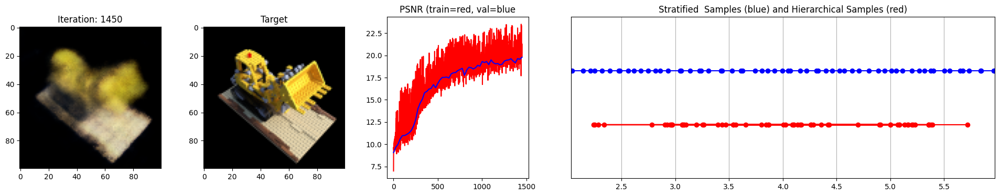

 30%|██▉       | 1475/5000 [11:22<25:06,  2.34it/s]

Loss: 0.011725109070539474


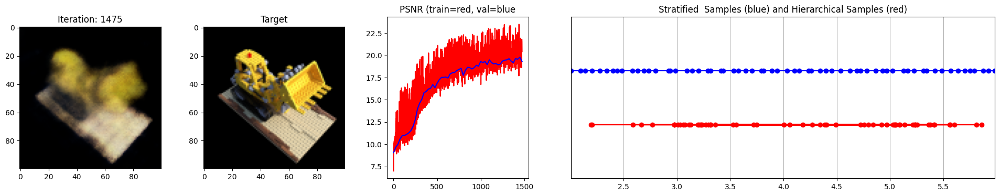

 30%|███       | 1500/5000 [11:33<25:05,  2.32it/s]

Loss: 0.011497603729367256


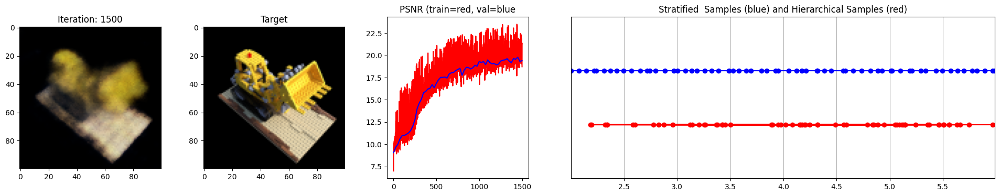

 30%|███       | 1525/5000 [11:45<24:57,  2.32it/s]

Loss: 0.01088791899383068


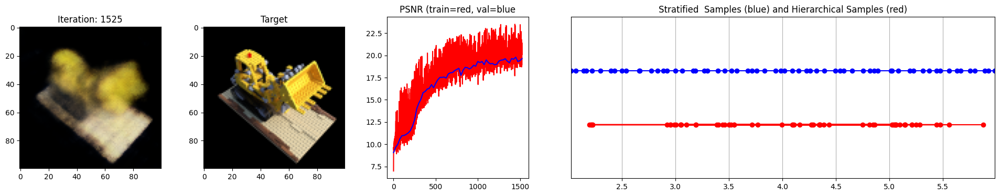

 31%|███       | 1550/5000 [11:57<24:33,  2.34it/s]

Loss: 0.010551444254815578


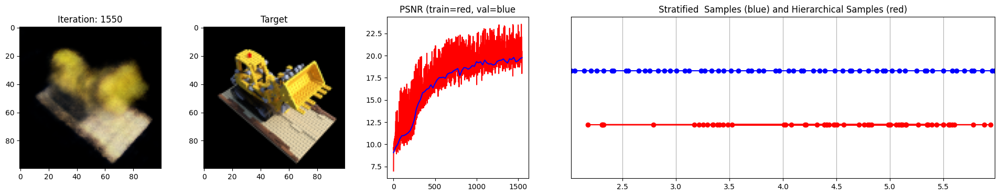

 32%|███▏      | 1575/5000 [12:09<24:24,  2.34it/s]

Loss: 0.01029256358742714


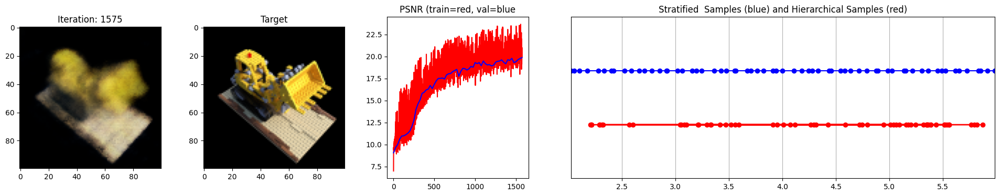

 32%|███▏      | 1600/5000 [12:21<24:14,  2.34it/s]

Loss: 0.010552557185292244


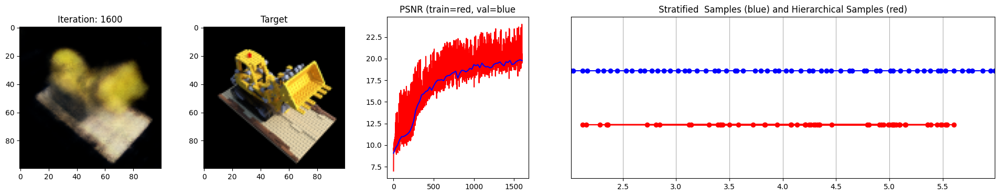

 32%|███▎      | 1625/5000 [12:33<24:01,  2.34it/s]

Loss: 0.010957974009215832


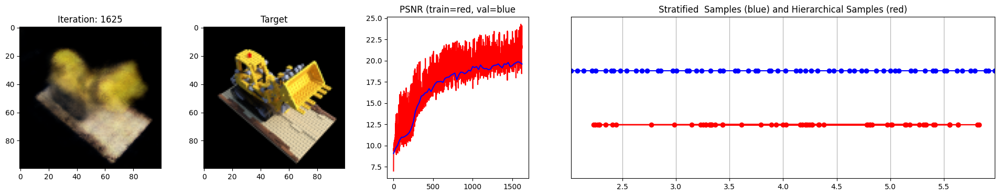

 33%|███▎      | 1650/5000 [12:44<23:50,  2.34it/s]

Loss: 0.010848036967217922


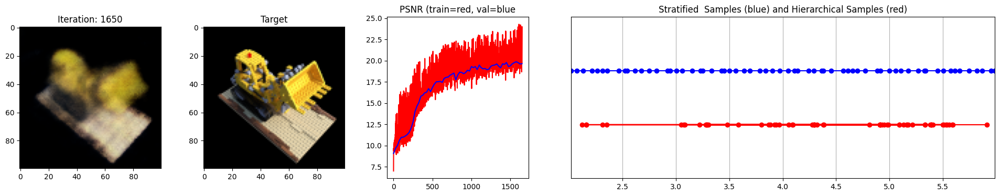

 34%|███▎      | 1675/5000 [12:56<23:59,  2.31it/s]

Loss: 0.010723423212766647


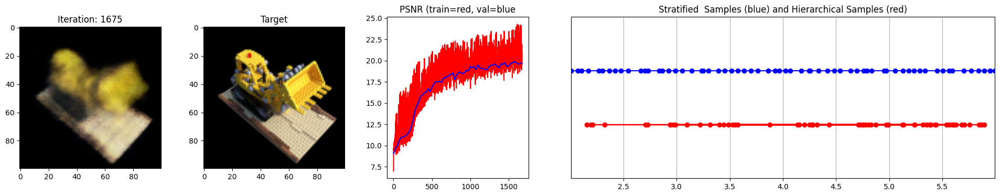

 34%|███▍      | 1700/5000 [13:08<23:24,  2.35it/s]

Loss: 0.009716526605188847


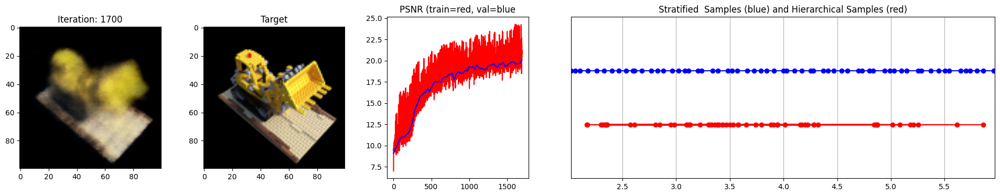

 34%|███▍      | 1725/5000 [13:20<23:17,  2.34it/s]

Loss: 0.009827381931245327


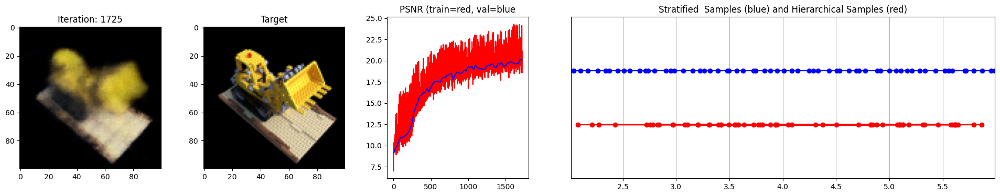

 35%|███▌      | 1750/5000 [13:32<23:16,  2.33it/s]

Loss: 0.009740754030644894


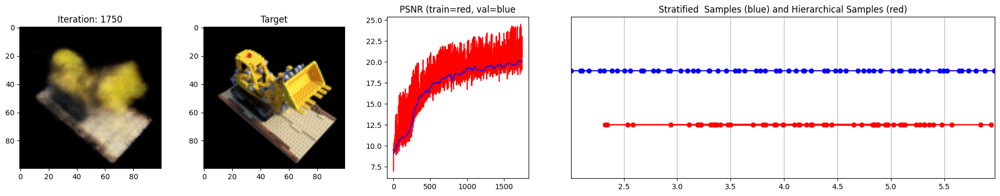

 36%|███▌      | 1775/5000 [13:44<22:57,  2.34it/s]

Loss: 0.009667822159826756


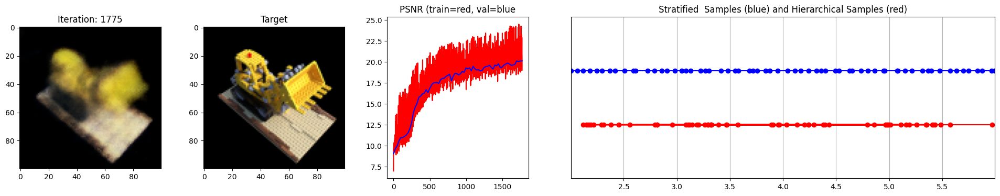

 36%|███▌      | 1800/5000 [13:56<22:43,  2.35it/s]

Loss: 0.009766636416316032


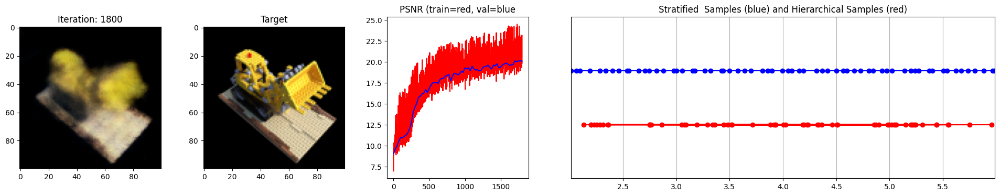

 36%|███▋      | 1825/5000 [14:07<22:43,  2.33it/s]

Loss: 0.009432007558643818


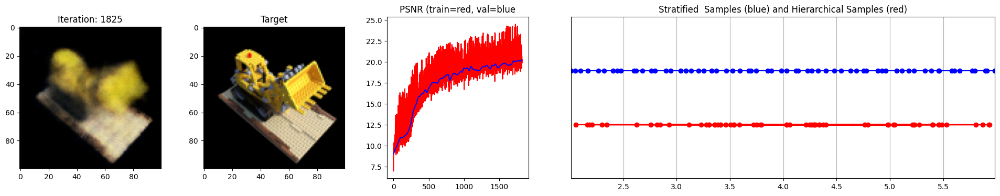

 37%|███▋      | 1850/5000 [14:19<22:23,  2.34it/s]

Loss: 0.009106824174523354


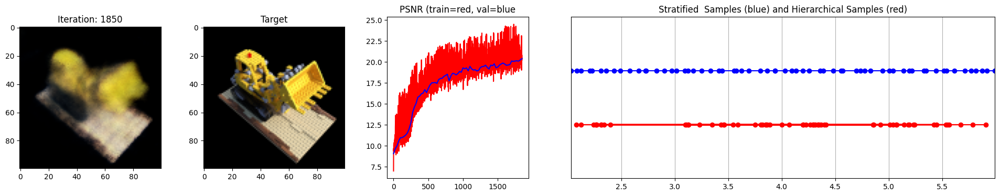

 38%|███▊      | 1875/5000 [14:31<22:17,  2.34it/s]

Loss: 0.010030380450189114


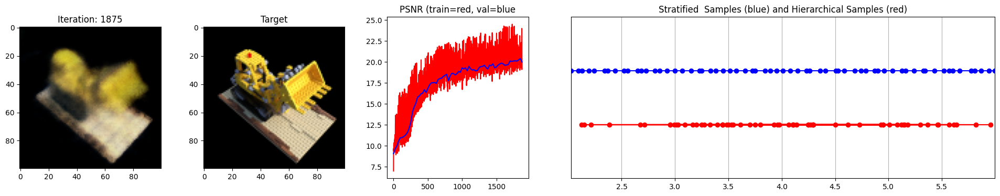

 38%|███▊      | 1900/5000 [14:43<22:19,  2.32it/s]

Loss: 0.009368430823087692


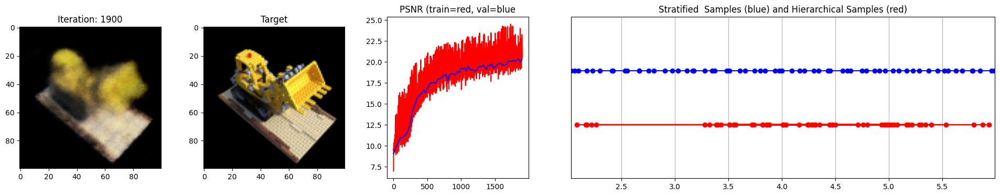

 38%|███▊      | 1925/5000 [14:55<21:51,  2.34it/s]

Loss: 0.0100486371666193


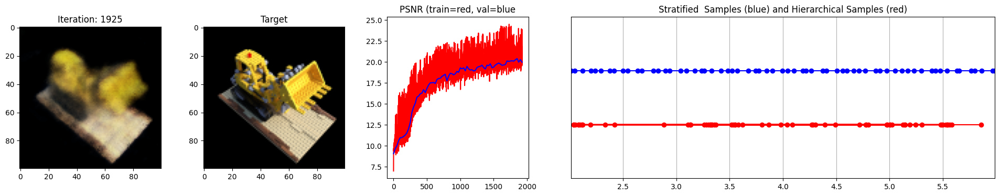

 39%|███▉      | 1950/5000 [15:06<21:47,  2.33it/s]

Loss: 0.009666327387094498


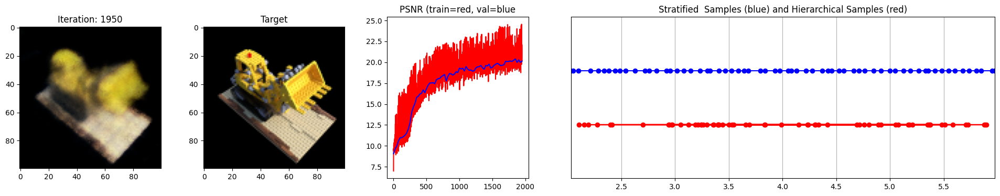

 40%|███▉      | 1975/5000 [15:18<21:36,  2.33it/s]

Loss: 0.009094920009374619


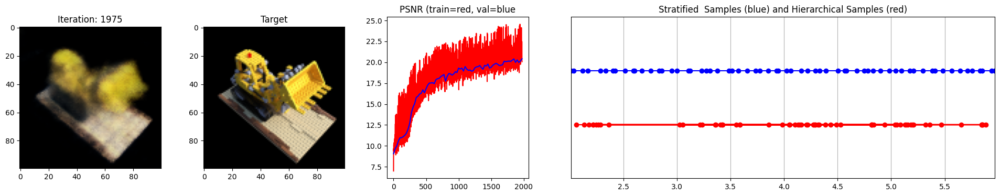

 40%|████      | 2000/5000 [15:30<21:19,  2.34it/s]

Loss: 0.009636029601097107


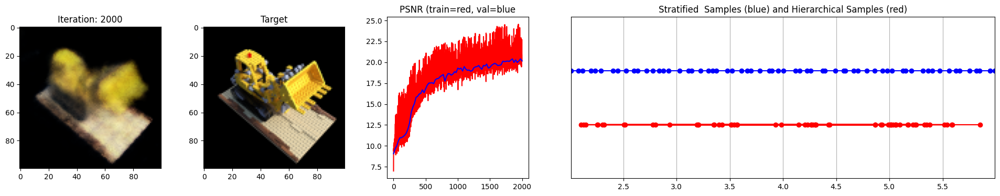

 40%|████      | 2025/5000 [15:42<21:18,  2.33it/s]

Loss: 0.00922173261642456


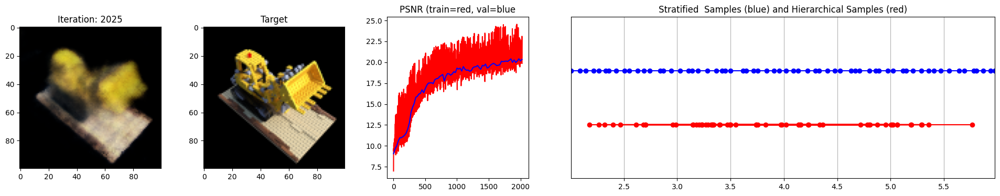

 41%|████      | 2050/5000 [15:54<21:05,  2.33it/s]

Loss: 0.009379741735756397


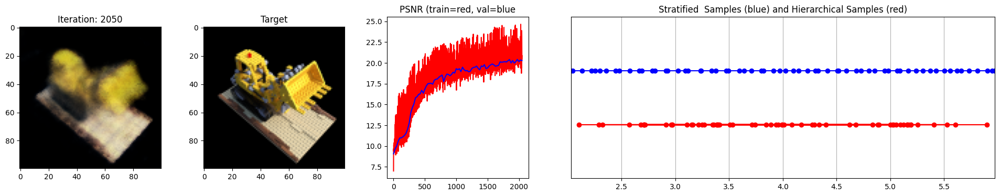

 42%|████▏     | 2075/5000 [16:06<20:46,  2.35it/s]

Loss: 0.008701739832758904


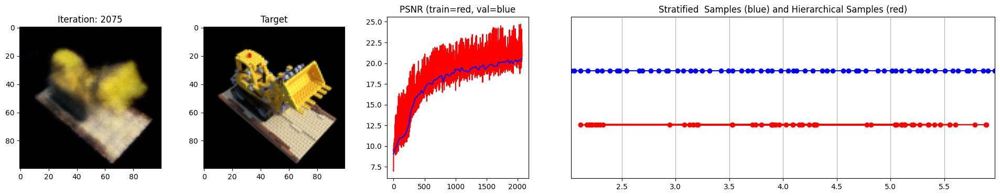

 42%|████▏     | 2100/5000 [16:17<20:45,  2.33it/s]

Loss: 0.009152337908744812


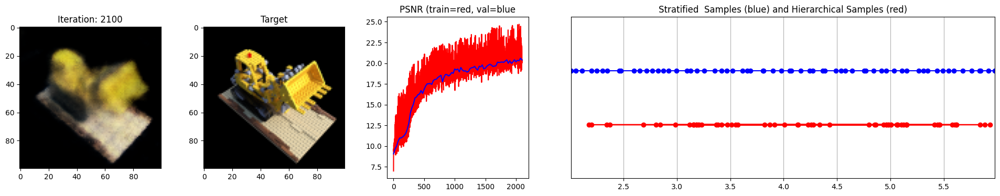

 42%|████▎     | 2125/5000 [16:29<20:31,  2.34it/s]

Loss: 0.009465521201491356


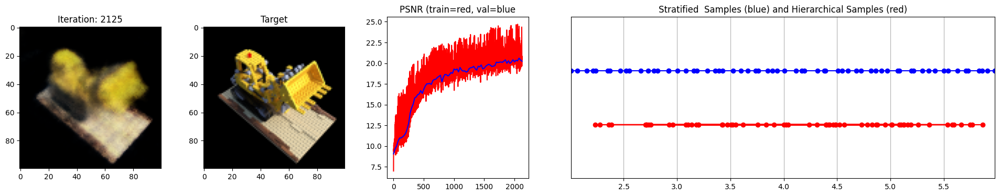

 43%|████▎     | 2150/5000 [16:41<20:18,  2.34it/s]

Loss: 0.009555330500006676


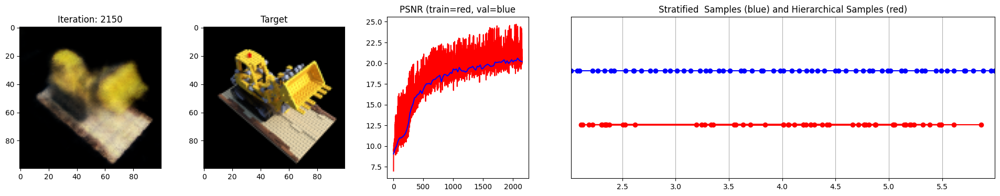

 44%|████▎     | 2175/5000 [16:53<20:13,  2.33it/s]

Loss: 0.008928341791033745


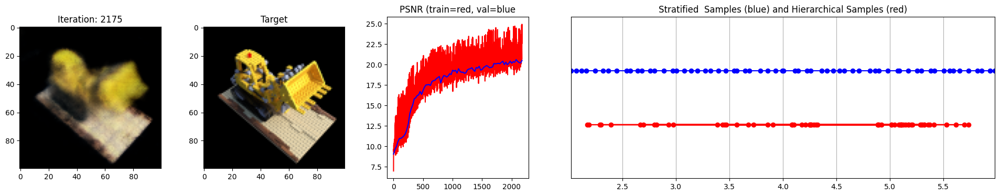

 44%|████▍     | 2200/5000 [17:05<19:53,  2.35it/s]

Loss: 0.009227869100868702


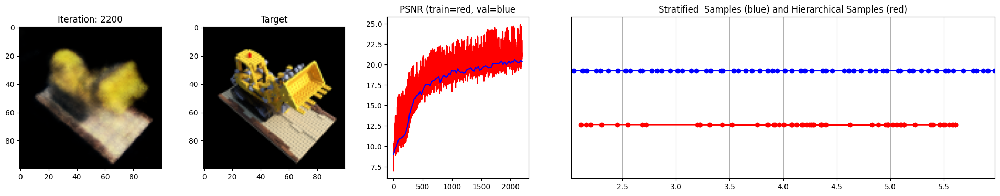

 44%|████▍     | 2225/5000 [17:17<19:47,  2.34it/s]

Loss: 0.009559486992657185


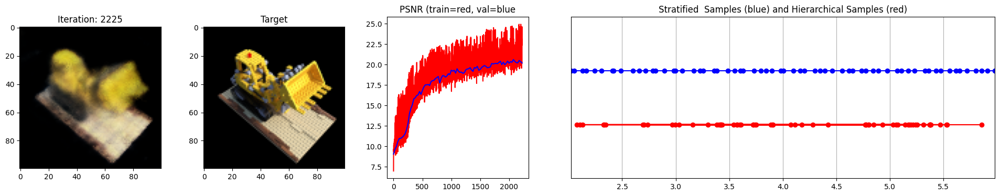

 45%|████▌     | 2250/5000 [17:29<19:52,  2.31it/s]

Loss: 0.008981193415820599


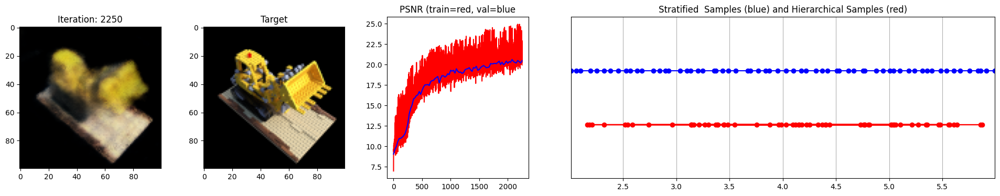

 46%|████▌     | 2275/5000 [17:41<19:21,  2.35it/s]

Loss: 0.00910681951791048


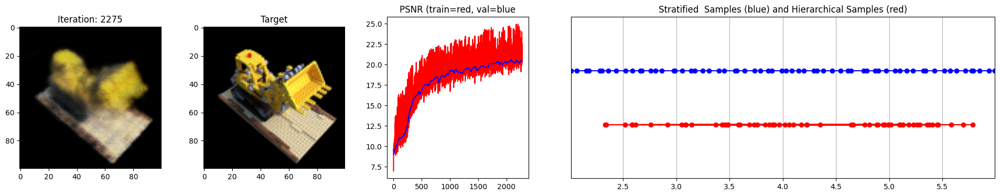

 46%|████▌     | 2300/5000 [17:53<19:11,  2.34it/s]

Loss: 0.009195066057145596


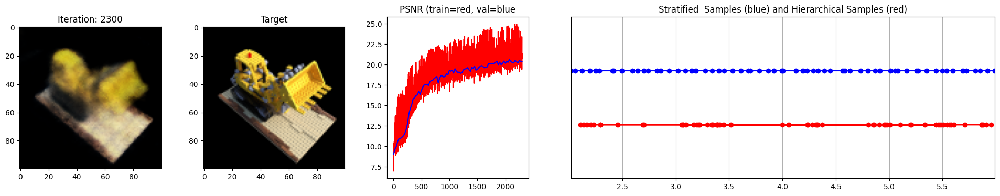

 46%|████▋     | 2325/5000 [18:05<19:04,  2.34it/s]

Loss: 0.009102283976972103


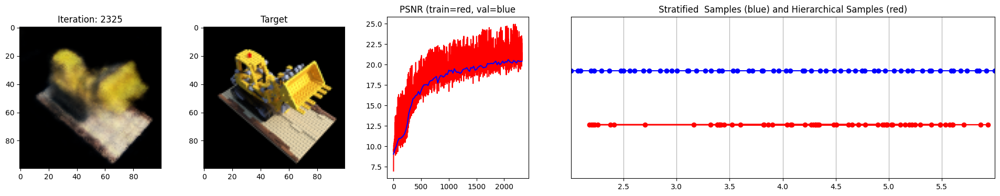

 47%|████▋     | 2350/5000 [18:17<18:47,  2.35it/s]

Loss: 0.008487244136631489


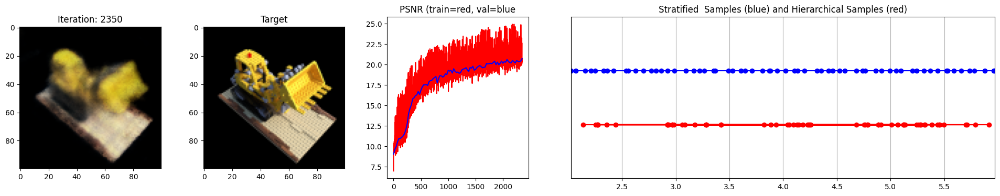

 48%|████▊     | 2375/5000 [18:28<18:47,  2.33it/s]

Loss: 0.008757567033171654


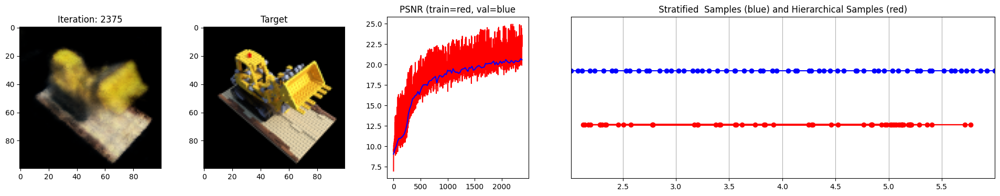

 48%|████▊     | 2400/5000 [18:40<18:33,  2.34it/s]

Loss: 0.009554151445627213


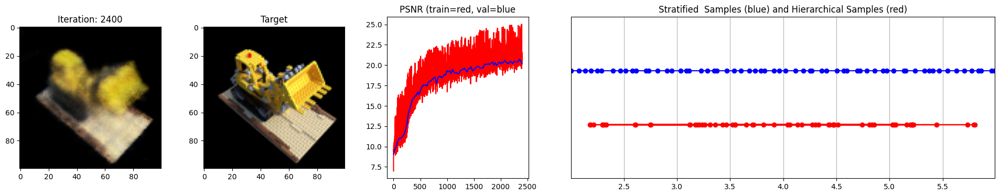

 48%|████▊     | 2425/5000 [18:52<18:19,  2.34it/s]

Loss: 0.008724977262318134


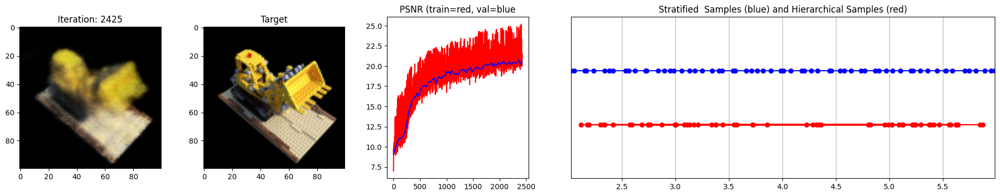

 49%|████▉     | 2450/5000 [19:04<18:11,  2.34it/s]

Loss: 0.008121686987578869


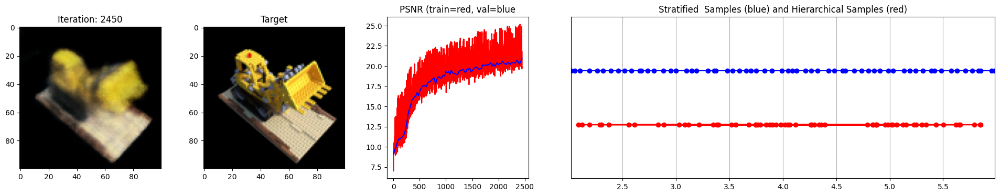

 50%|████▉     | 2475/5000 [19:16<18:08,  2.32it/s]

Loss: 0.00829252228140831


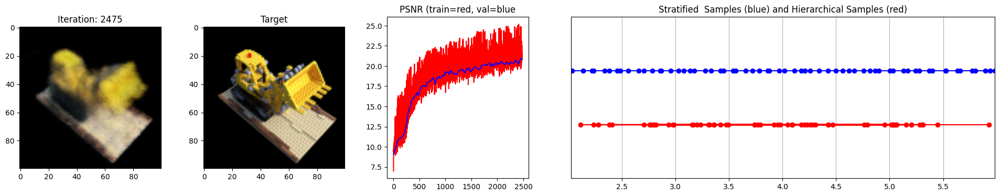

 50%|█████     | 2500/5000 [19:29<17:44,  2.35it/s]

Loss: 0.008810583502054214


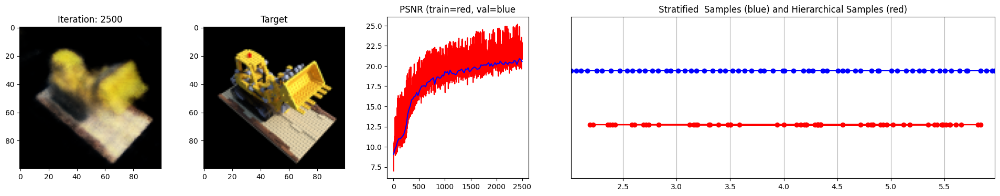

 50%|█████     | 2525/5000 [19:40<17:41,  2.33it/s]

Loss: 0.007940514013171196


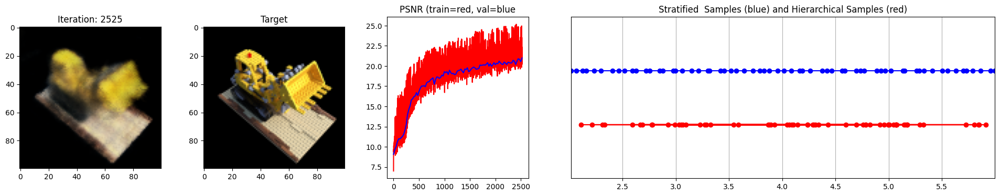

 51%|█████     | 2550/5000 [19:52<17:24,  2.34it/s]

Loss: 0.009172849357128143


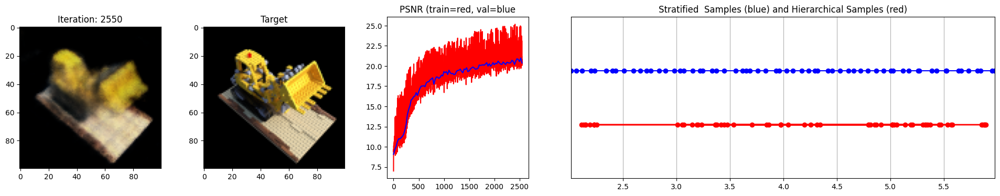

 52%|█████▏    | 2575/5000 [20:04<17:21,  2.33it/s]

Loss: 0.008672064170241356


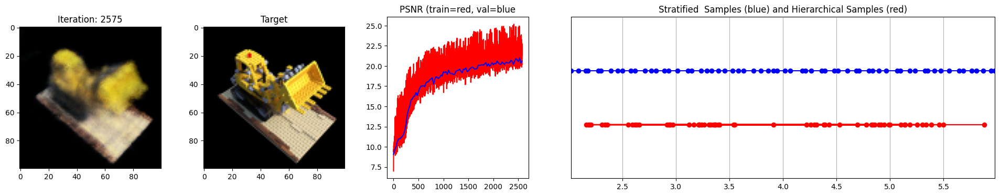

 52%|█████▏    | 2600/5000 [20:16<17:16,  2.32it/s]

Loss: 0.0080396868288517


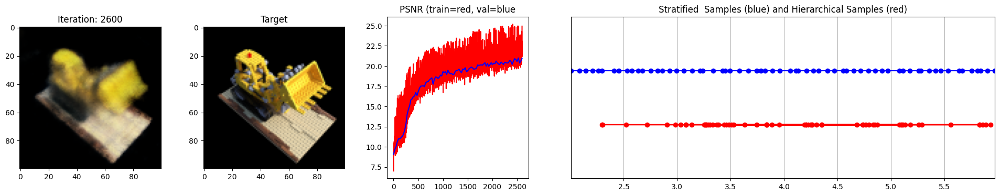

 52%|█████▎    | 2625/5000 [20:28<16:56,  2.34it/s]

Loss: 0.008290823549032211


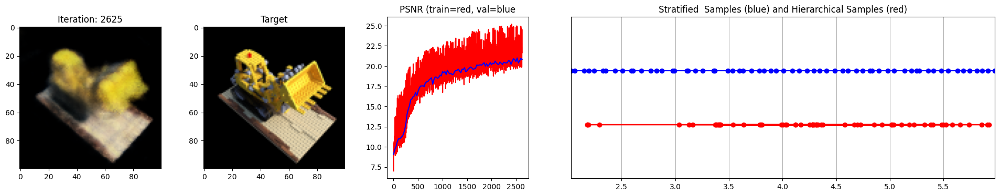

 53%|█████▎    | 2650/5000 [20:40<16:48,  2.33it/s]

Loss: 0.008421426638960838


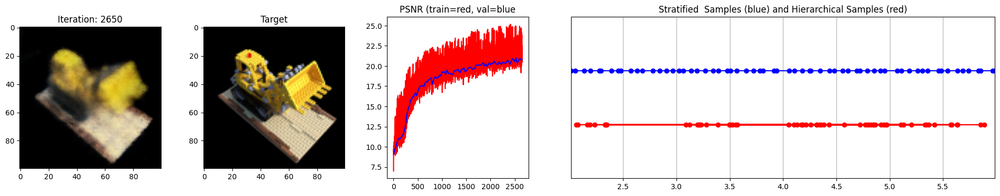

 54%|█████▎    | 2675/5000 [20:52<16:36,  2.33it/s]

Loss: 0.007964009419083595


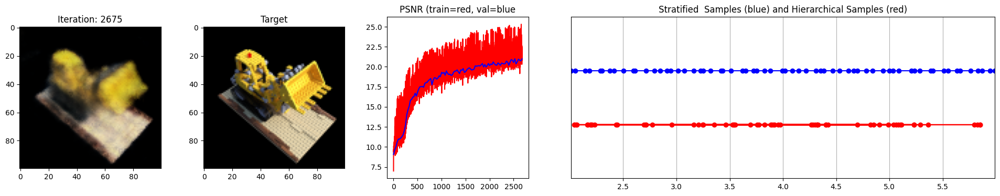

 54%|█████▍    | 2700/5000 [21:04<16:20,  2.35it/s]

Loss: 0.009054924361407757


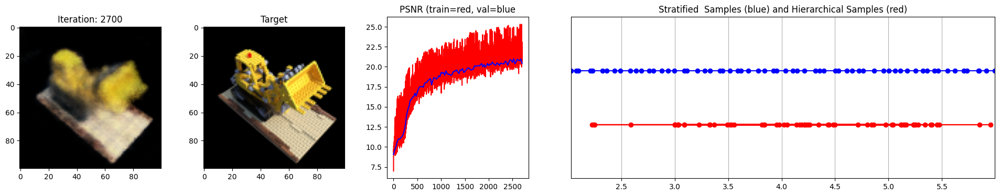

 55%|█████▍    | 2725/5000 [21:16<16:19,  2.32it/s]

Loss: 0.00884872954338789


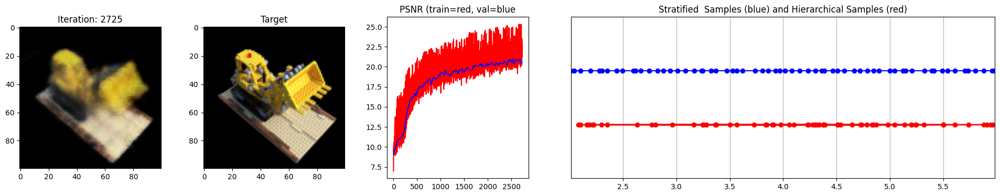

 55%|█████▌    | 2750/5000 [21:28<16:03,  2.34it/s]

Loss: 0.008317327126860619


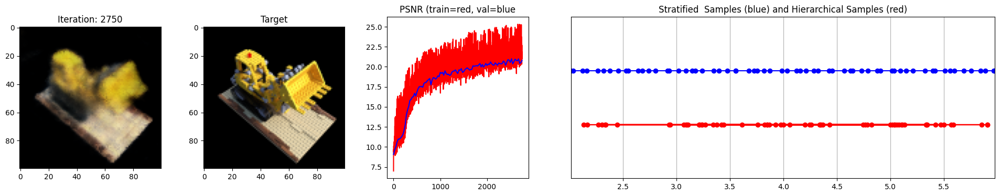

 56%|█████▌    | 2775/5000 [21:40<15:57,  2.32it/s]

Loss: 0.008868255652487278


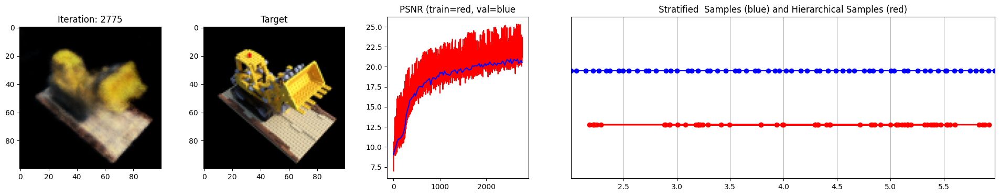

 56%|█████▌    | 2800/5000 [21:52<15:43,  2.33it/s]

Loss: 0.007943956181406975


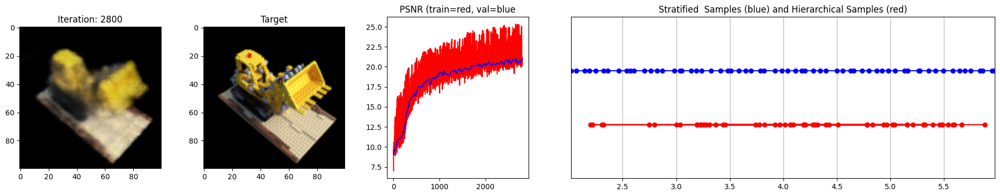

 56%|█████▋    | 2825/5000 [22:04<15:29,  2.34it/s]

Loss: 0.008132348768413067


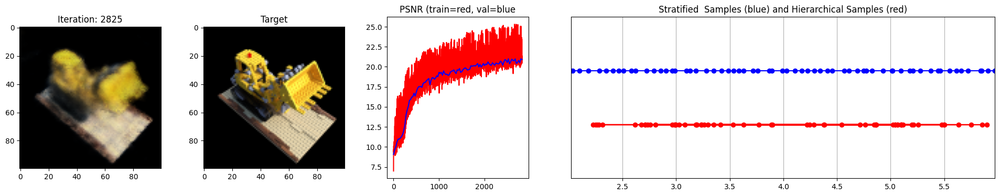

 57%|█████▋    | 2850/5000 [22:16<15:24,  2.33it/s]

Loss: 0.008044709451496601


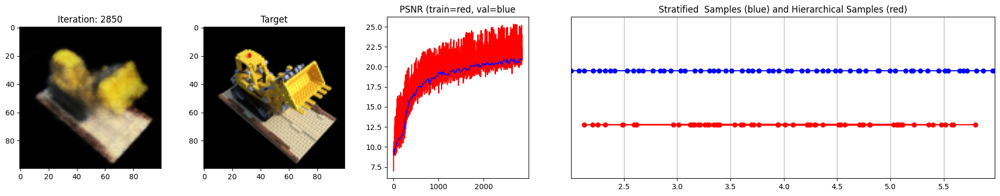

 57%|█████▊    | 2875/5000 [22:28<15:17,  2.32it/s]

Loss: 0.007418219931423664


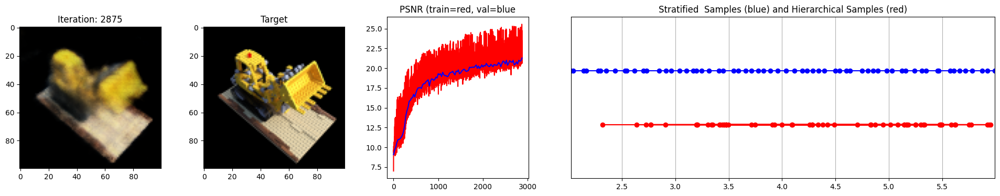

 58%|█████▊    | 2900/5000 [22:40<14:56,  2.34it/s]

Loss: 0.007939652539789677


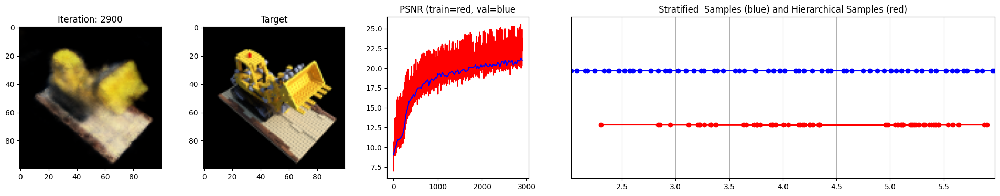

 58%|█████▊    | 2925/5000 [22:52<14:54,  2.32it/s]

Loss: 0.007757621351629496


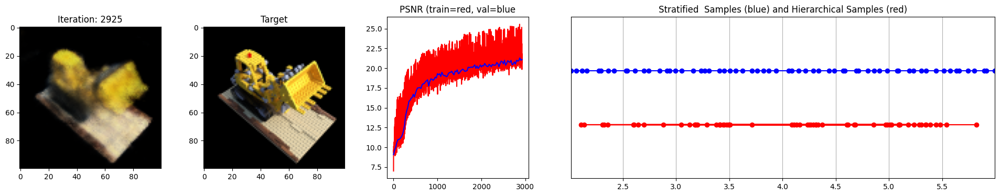

 59%|█████▉    | 2950/5000 [23:04<14:38,  2.33it/s]

Loss: 0.007694721221923828


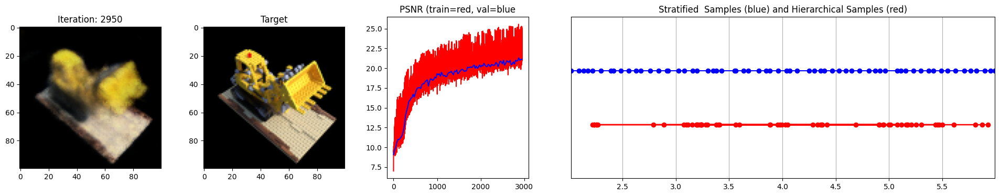

 60%|█████▉    | 2975/5000 [23:16<14:28,  2.33it/s]

Loss: 0.007797003258019686


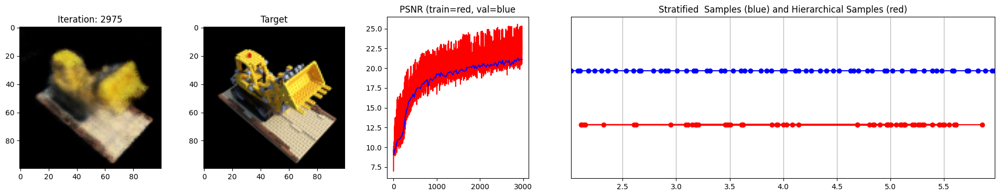

 60%|██████    | 3000/5000 [23:28<14:17,  2.33it/s]

Loss: 0.007885249331593513


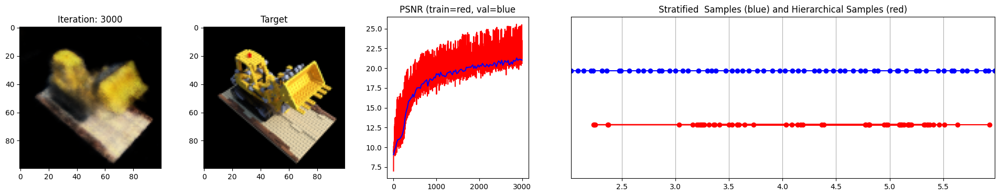

 60%|██████    | 3025/5000 [23:40<14:09,  2.32it/s]

Loss: 0.007383610121905804


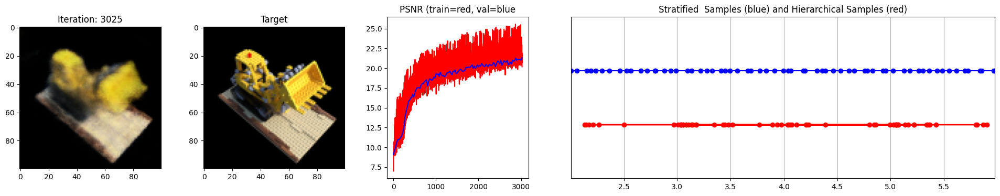

 61%|██████    | 3050/5000 [23:52<13:55,  2.33it/s]

Loss: 0.008107384666800499


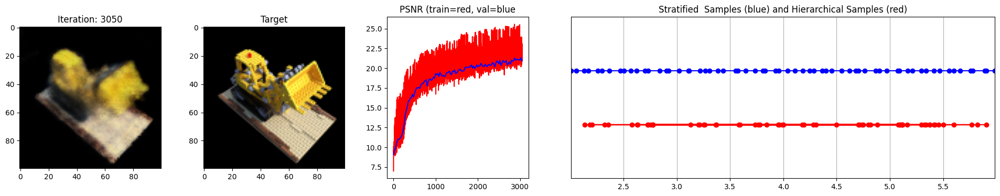

 62%|██████▏   | 3075/5000 [24:04<13:49,  2.32it/s]

Loss: 0.0076552489772439


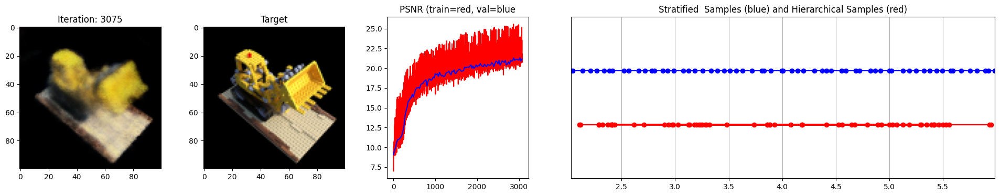

 62%|██████▏   | 3100/5000 [24:16<13:31,  2.34it/s]

Loss: 0.00757901044562459


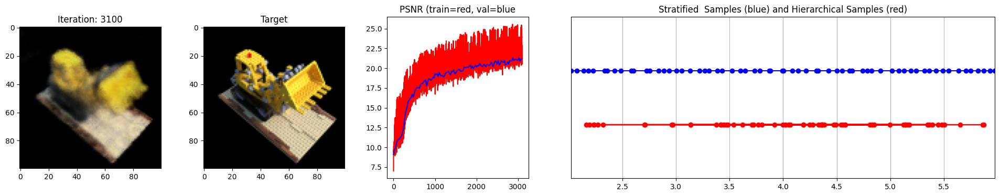

 62%|██████▎   | 3125/5000 [24:28<13:25,  2.33it/s]

Loss: 0.007600961718708277


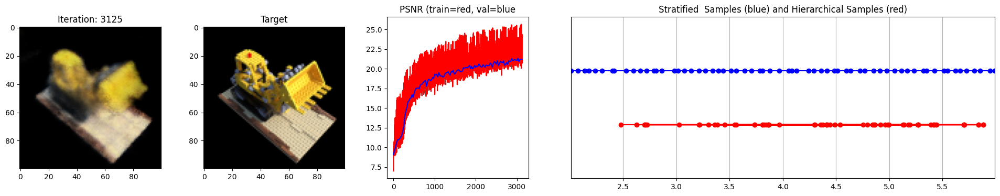

 63%|██████▎   | 3150/5000 [24:40<13:22,  2.31it/s]

Loss: 0.007888861000537872


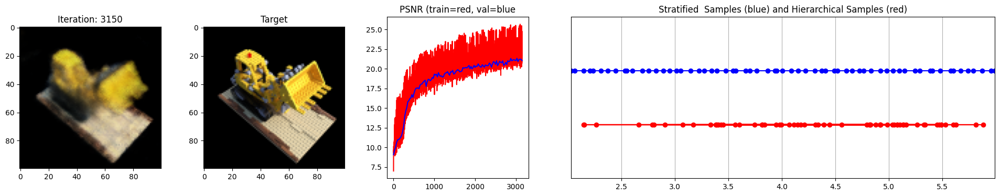

 64%|██████▎   | 3175/5000 [24:52<13:00,  2.34it/s]

Loss: 0.007936966605484486


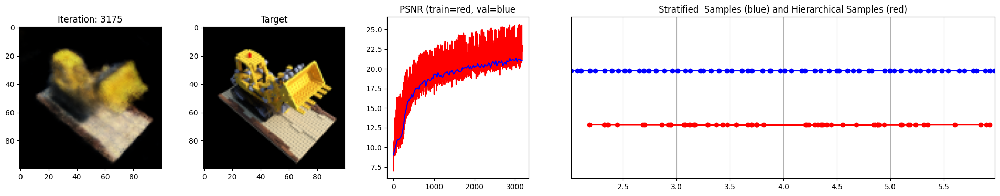

 64%|██████▍   | 3200/5000 [25:04<12:50,  2.33it/s]

Loss: 0.007541877683252096


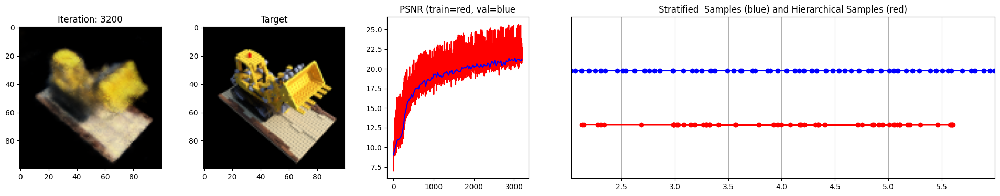

 64%|██████▍   | 3225/5000 [25:17<12:45,  2.32it/s]

Loss: 0.007548759691417217


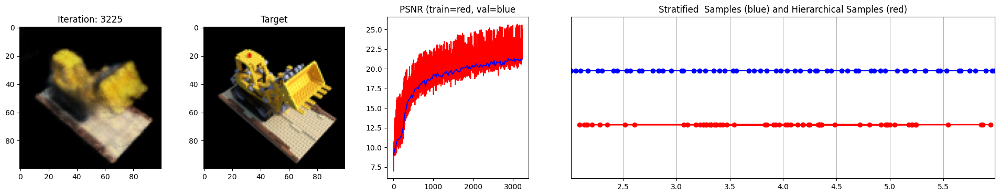

 65%|██████▌   | 3250/5000 [25:29<12:30,  2.33it/s]

Loss: 0.007646266836673021


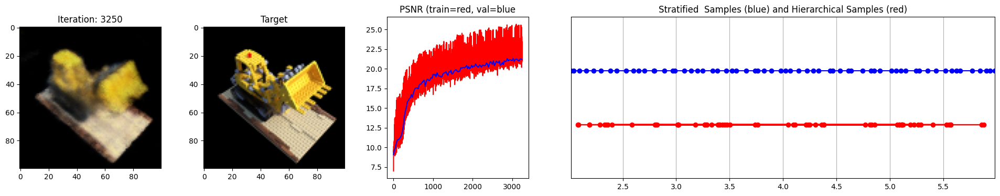

 66%|██████▌   | 3275/5000 [25:41<12:21,  2.32it/s]

Loss: 0.0071749198250472546


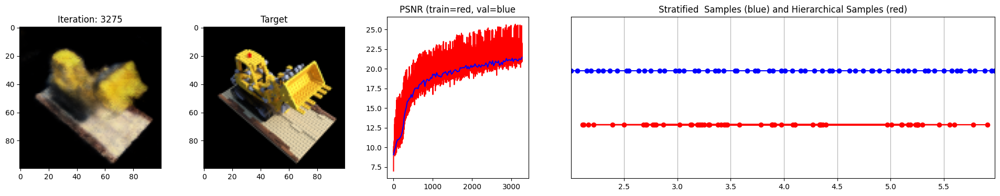

 66%|██████▌   | 3300/5000 [25:53<12:08,  2.33it/s]

Loss: 0.007360481657087803


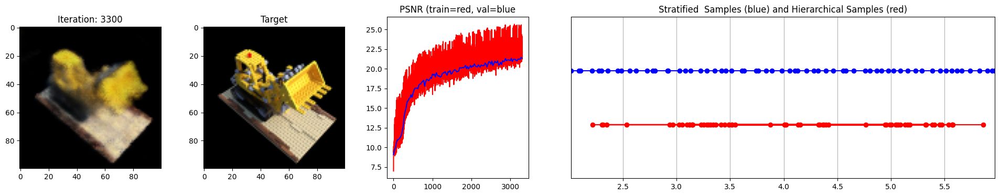

 66%|██████▋   | 3325/5000 [26:05<11:58,  2.33it/s]

Loss: 0.007515449542552233


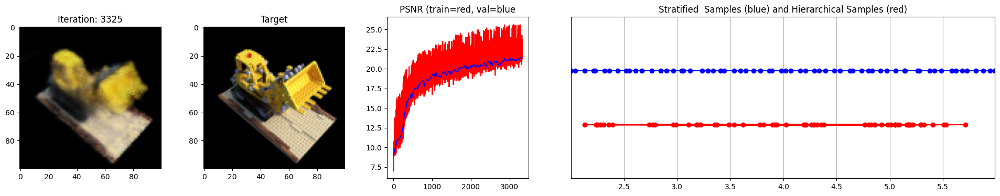

 67%|██████▋   | 3350/5000 [26:17<11:56,  2.30it/s]

Loss: 0.007678148336708546


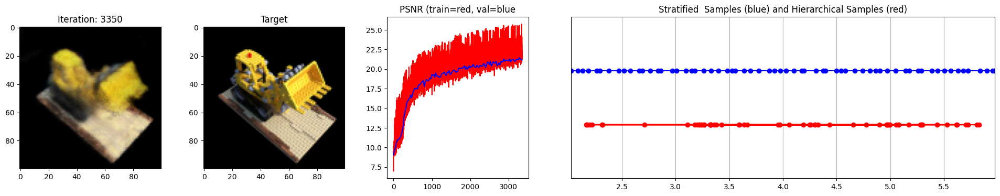

 68%|██████▊   | 3375/5000 [26:29<11:35,  2.34it/s]

Loss: 0.007812843658030033


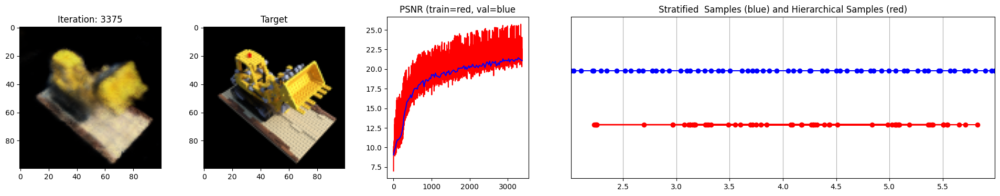

 68%|██████▊   | 3400/5000 [26:41<11:28,  2.32it/s]

Loss: 0.0072073861956596375


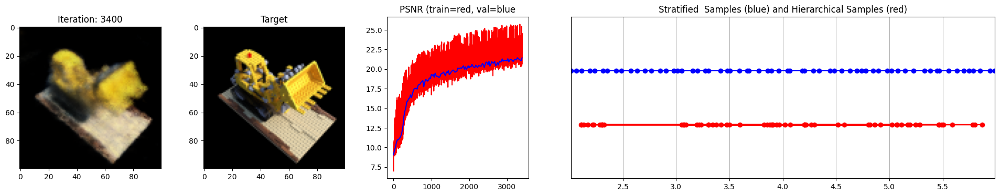

 68%|██████▊   | 3425/5000 [26:53<11:18,  2.32it/s]

Loss: 0.0075102620758116245


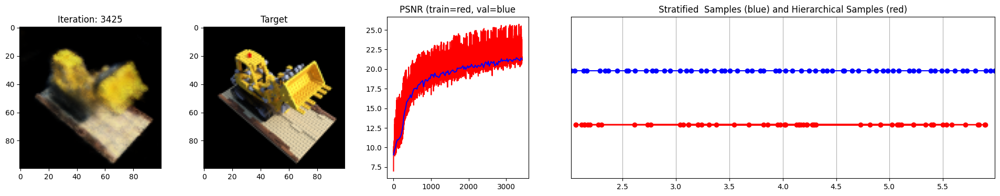

 69%|██████▉   | 3450/5000 [27:05<11:03,  2.34it/s]

Loss: 0.007264011539518833


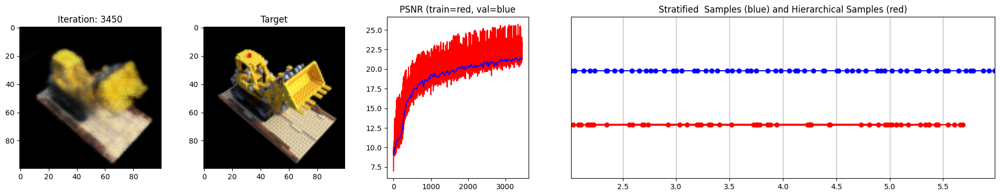

 70%|██████▉   | 3475/5000 [27:17<10:54,  2.33it/s]

Loss: 0.007053817622363567


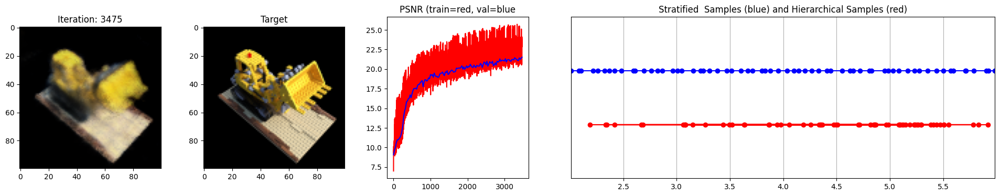

 70%|███████   | 3500/5000 [27:29<10:51,  2.30it/s]

Loss: 0.00710492255166173


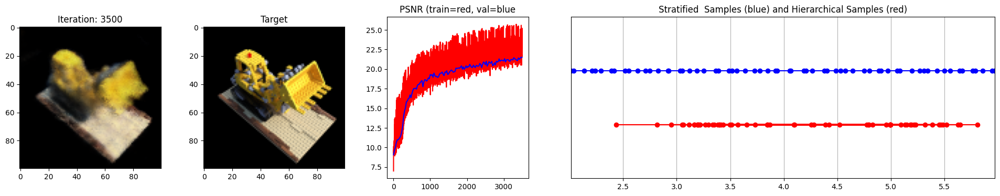

 70%|███████   | 3525/5000 [27:42<10:29,  2.34it/s]

Loss: 0.007371734827756882


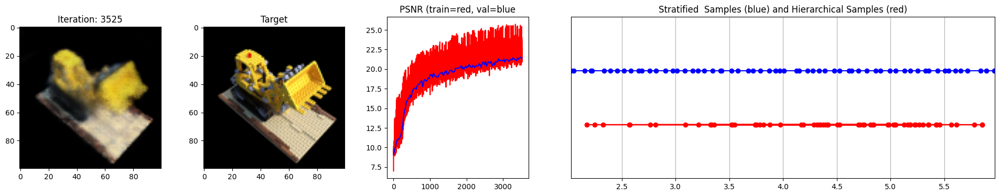

 71%|███████   | 3550/5000 [27:53<10:20,  2.34it/s]

Loss: 0.007404871750622988


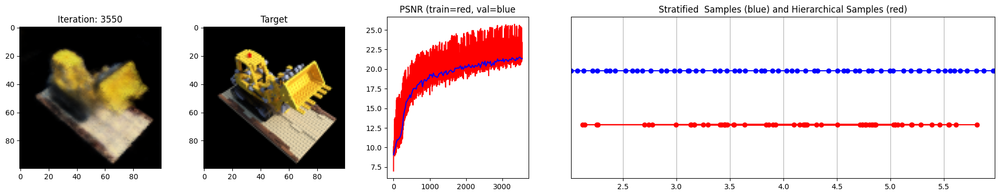

 72%|███████▏  | 3575/5000 [28:05<10:13,  2.32it/s]

Loss: 0.006951272487640381


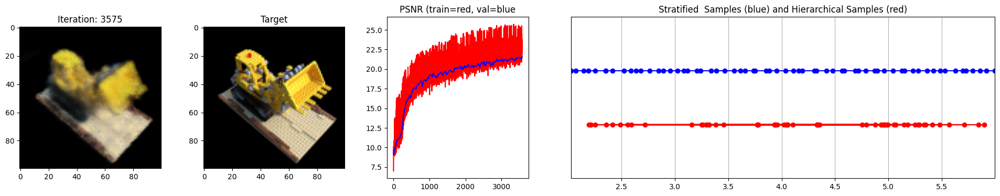

 72%|███████▏  | 3600/5000 [28:18<09:59,  2.33it/s]

Loss: 0.007789993658661842


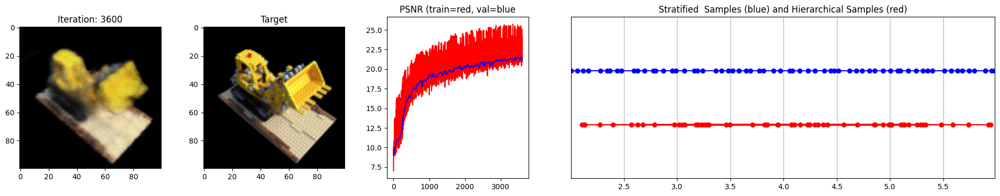

 72%|███████▎  | 3625/5000 [28:29<09:50,  2.33it/s]

Loss: 0.0072927046567201614


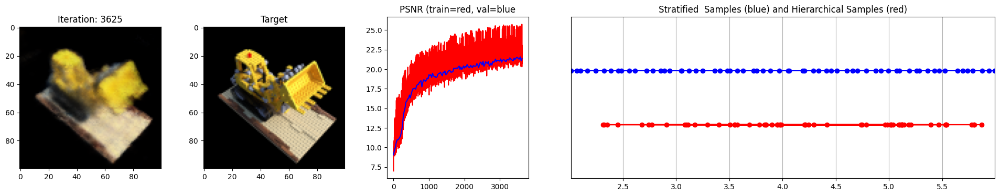

 73%|███████▎  | 3650/5000 [28:42<09:38,  2.33it/s]

Loss: 0.006670674774795771


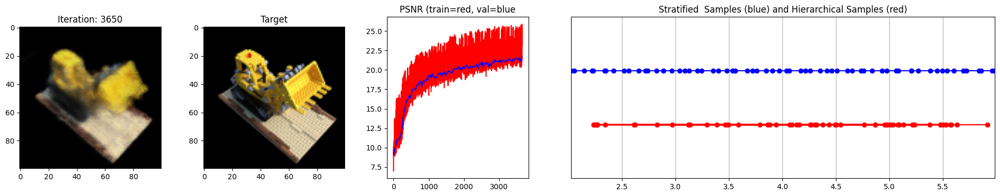

 74%|███████▎  | 3675/5000 [28:54<09:29,  2.33it/s]

Loss: 0.007025592029094696


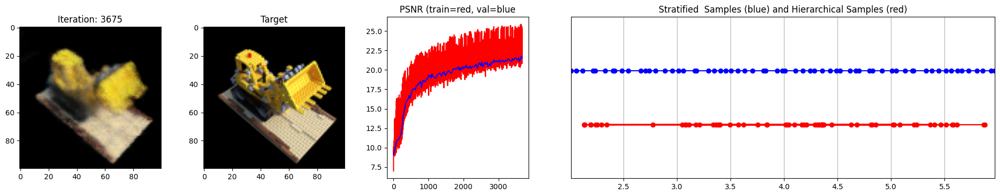

 74%|███████▍  | 3700/5000 [29:06<09:20,  2.32it/s]

Loss: 0.007066837977617979


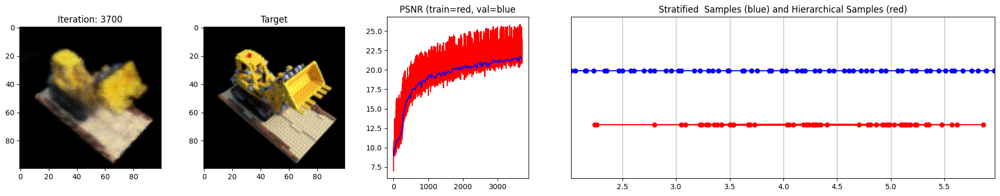

 74%|███████▍  | 3725/5000 [29:18<09:05,  2.34it/s]

Loss: 0.007210145238786936


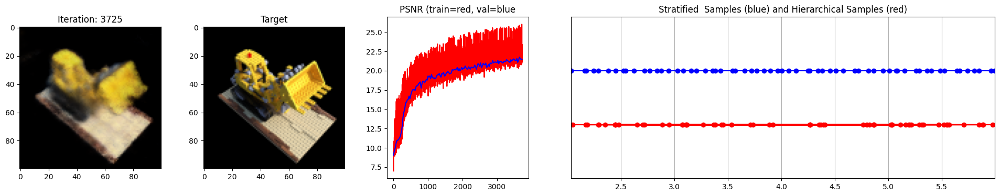

 75%|███████▌  | 3750/5000 [29:30<08:52,  2.35it/s]

Loss: 0.007077790331095457


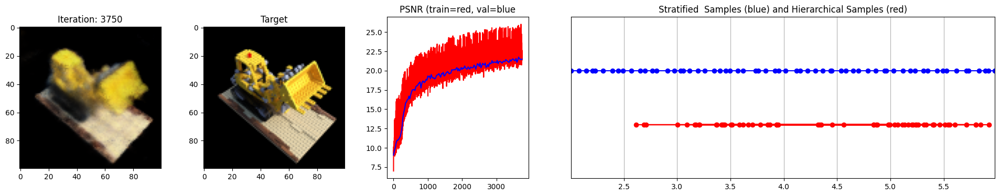

 76%|███████▌  | 3775/5000 [29:42<08:45,  2.33it/s]

Loss: 0.00719081237912178


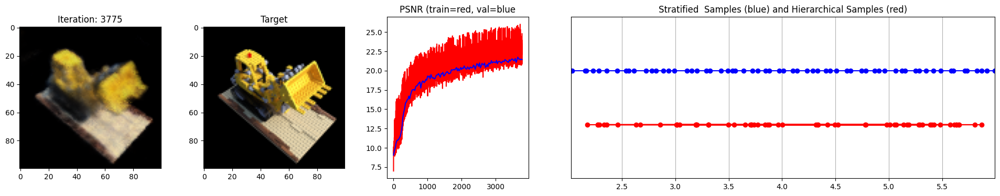

 76%|███████▌  | 3800/5000 [29:54<08:34,  2.33it/s]

Loss: 0.007064836099743843


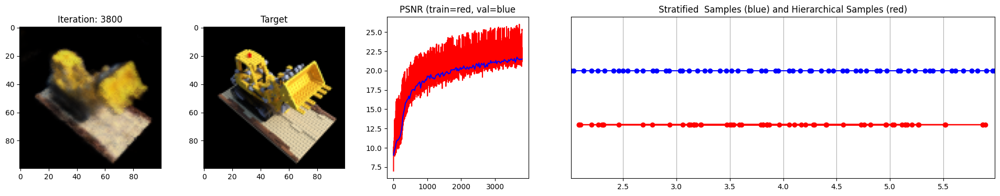

 76%|███████▋  | 3825/5000 [30:06<08:24,  2.33it/s]

Loss: 0.007306995335966349


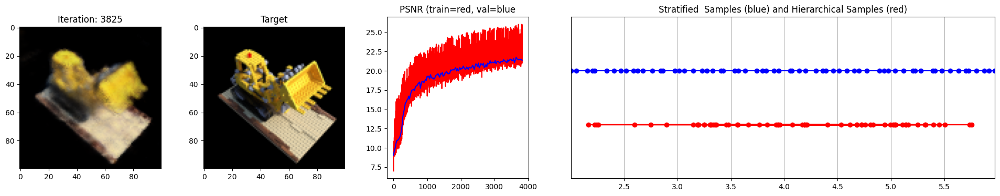

 77%|███████▋  | 3850/5000 [30:18<08:15,  2.32it/s]

Loss: 0.0072732656262815


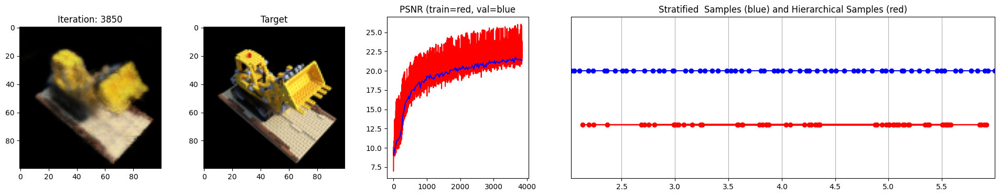

 78%|███████▊  | 3875/5000 [30:30<08:03,  2.33it/s]

Loss: 0.0069162724539637566


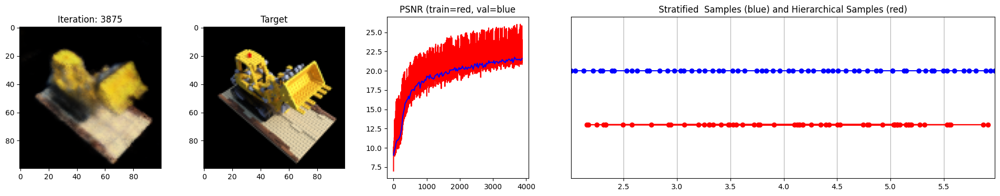

 78%|███████▊  | 3900/5000 [30:42<07:54,  2.32it/s]

Loss: 0.006970267277210951


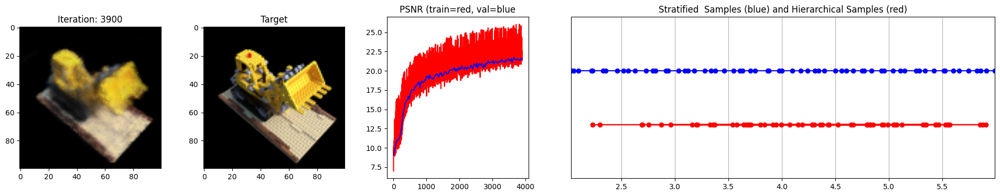

 78%|███████▊  | 3925/5000 [30:54<07:41,  2.33it/s]

Loss: 0.006600950378924608


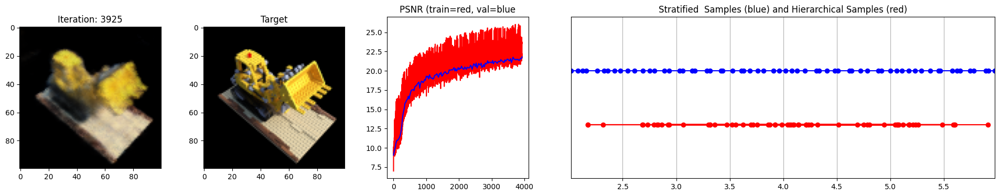

 79%|███████▉  | 3950/5000 [31:06<07:30,  2.33it/s]

Loss: 0.006670346949249506


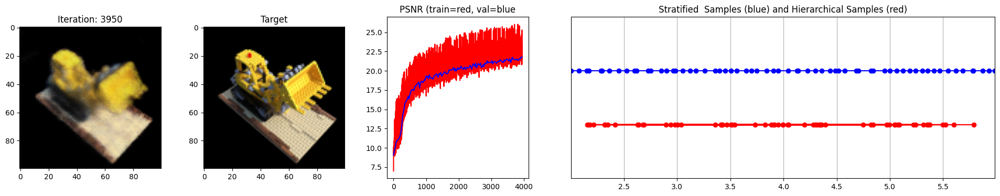

 80%|███████▉  | 3975/5000 [31:19<07:20,  2.33it/s]

Loss: 0.006533848121762276


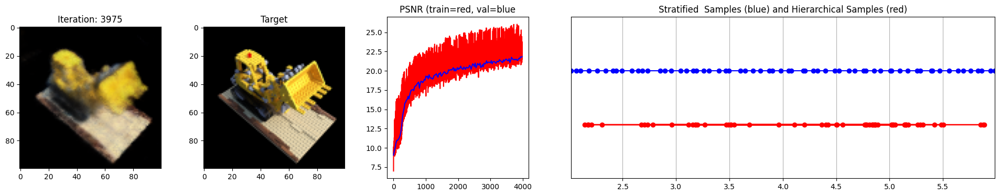

 80%|████████  | 4000/5000 [31:31<07:07,  2.34it/s]

Loss: 0.006873042322695255


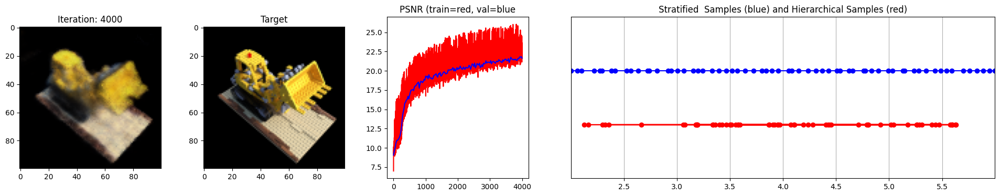

 80%|████████  | 4025/5000 [31:43<06:59,  2.33it/s]

Loss: 0.0062985289841890335


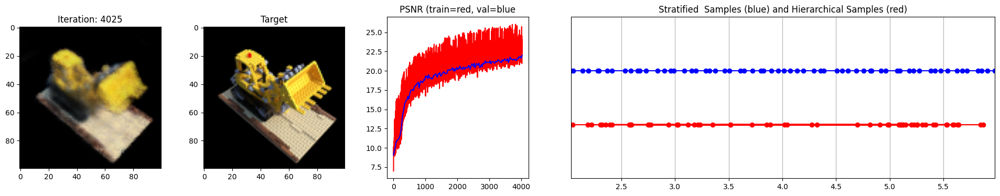

 81%|████████  | 4050/5000 [31:55<06:51,  2.31it/s]

Loss: 0.006516873370856047


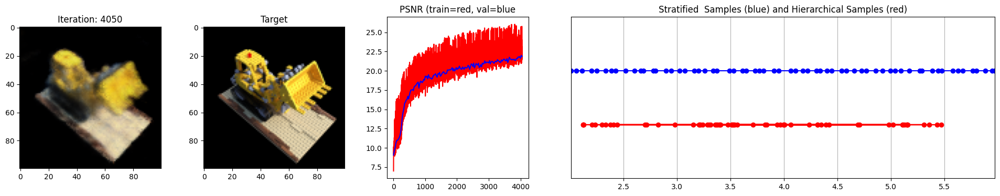

 82%|████████▏ | 4075/5000 [32:07<06:38,  2.32it/s]

Loss: 0.006468662526458502


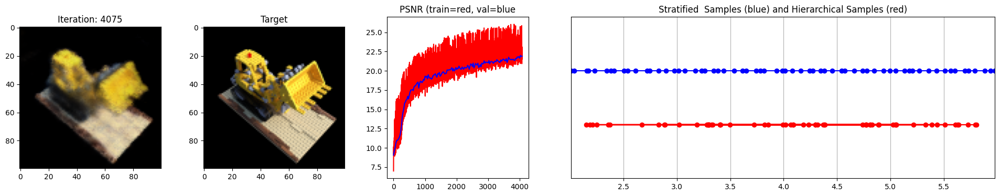

 82%|████████▏ | 4100/5000 [32:19<06:29,  2.31it/s]

Loss: 0.00641304487362504


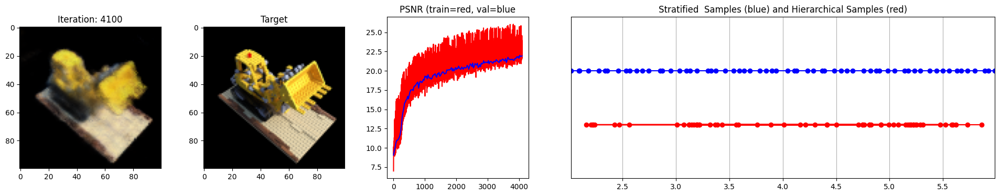

 82%|████████▎ | 4125/5000 [32:31<06:15,  2.33it/s]

Loss: 0.006409133784472942


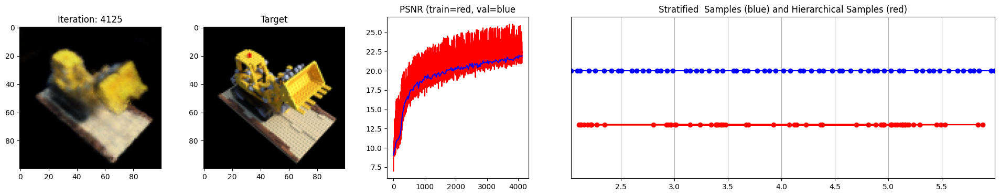

 83%|████████▎ | 4150/5000 [32:43<06:04,  2.33it/s]

Loss: 0.007050081621855497


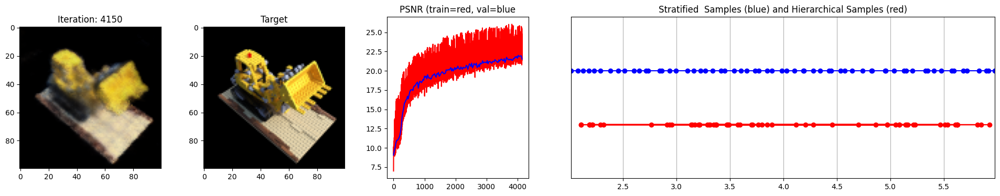

 84%|████████▎ | 4175/5000 [32:55<05:53,  2.33it/s]

Loss: 0.006335678044706583


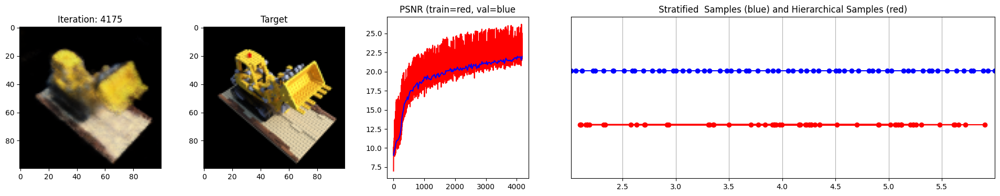

 84%|████████▍ | 4200/5000 [33:07<05:43,  2.33it/s]

Loss: 0.0066164820455014706


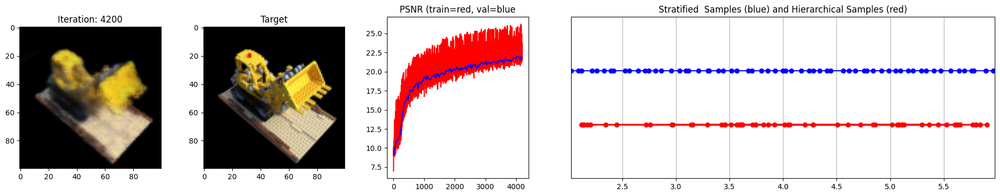

 84%|████████▍ | 4225/5000 [33:19<05:31,  2.34it/s]

Loss: 0.006863740272819996


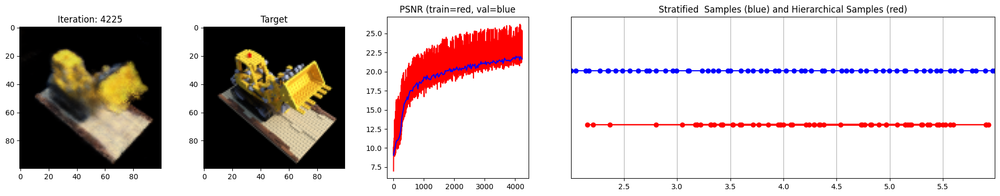

 85%|████████▌ | 4250/5000 [33:31<05:20,  2.34it/s]

Loss: 0.006653984077274799


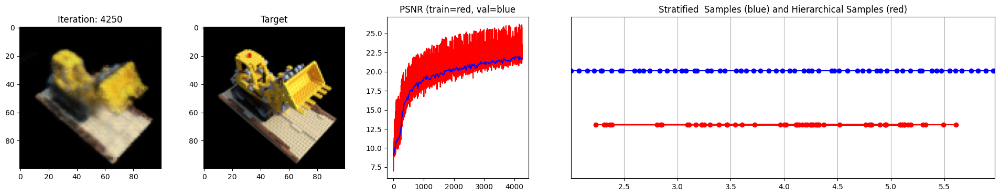

 86%|████████▌ | 4275/5000 [33:43<05:10,  2.34it/s]

Loss: 0.0067870765924453735


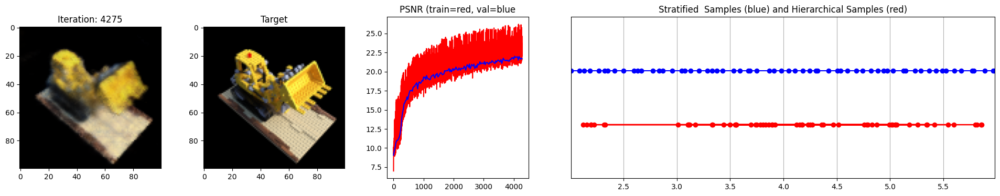

 86%|████████▌ | 4300/5000 [33:55<05:00,  2.33it/s]

Loss: 0.0068975635804235935


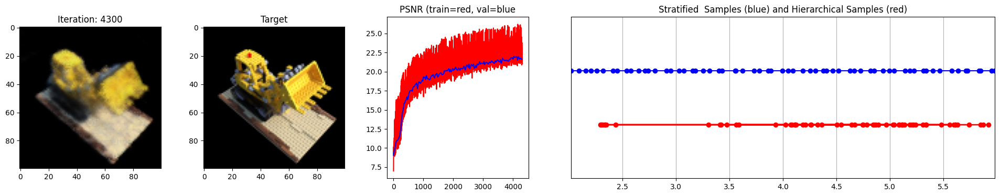

 86%|████████▋ | 4325/5000 [34:07<04:52,  2.31it/s]

Loss: 0.006566290277987719


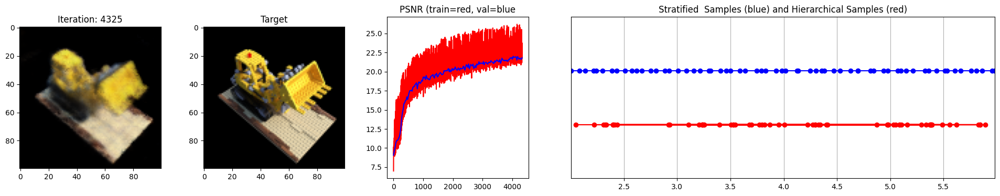

 87%|████████▋ | 4350/5000 [34:20<04:38,  2.33it/s]

Loss: 0.006527791731059551


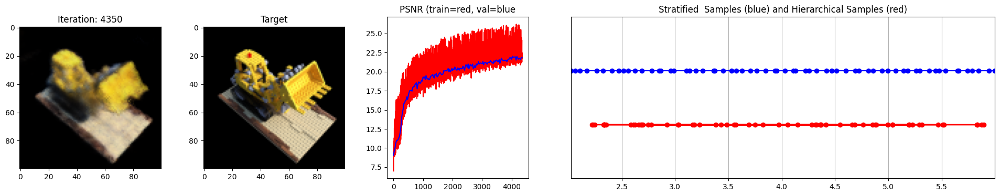

 88%|████████▊ | 4375/5000 [34:32<04:28,  2.33it/s]

Loss: 0.00637495331466198


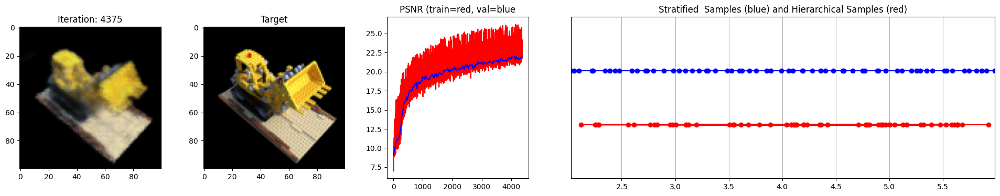

 88%|████████▊ | 4400/5000 [34:43<04:16,  2.34it/s]

Loss: 0.006516635417938232


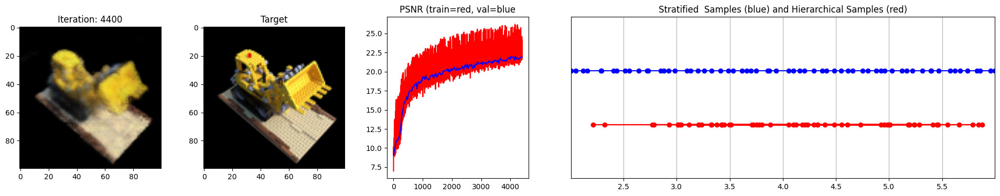

 88%|████████▊ | 4425/5000 [34:56<04:06,  2.33it/s]

Loss: 0.006969455163925886


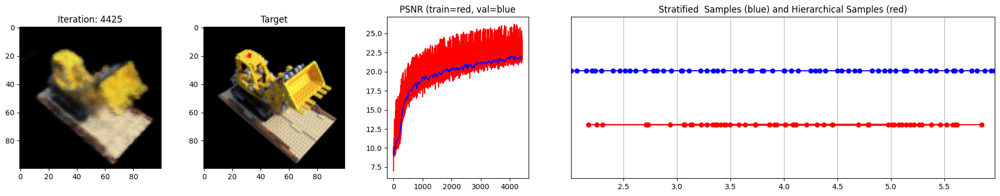

 89%|████████▉ | 4450/5000 [35:08<03:55,  2.33it/s]

Loss: 0.006012197583913803


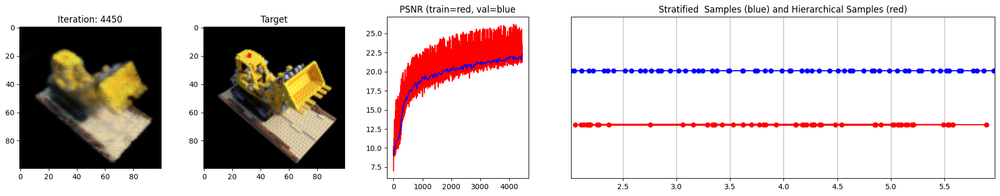

 90%|████████▉ | 4475/5000 [35:20<03:45,  2.33it/s]

Loss: 0.006458142772316933


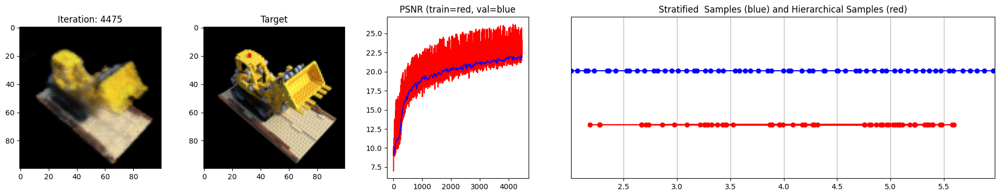

 90%|█████████ | 4500/5000 [35:32<03:34,  2.33it/s]

Loss: 0.0062767695635557175


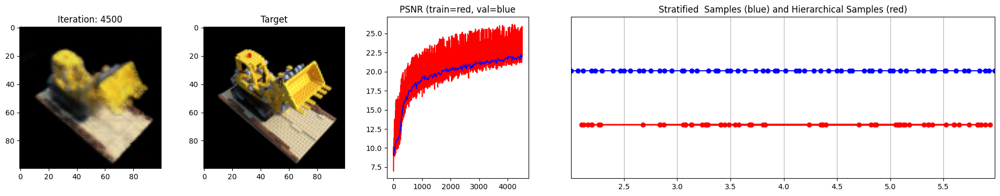

 90%|█████████ | 4525/5000 [35:44<03:26,  2.30it/s]

Loss: 0.006183880381286144


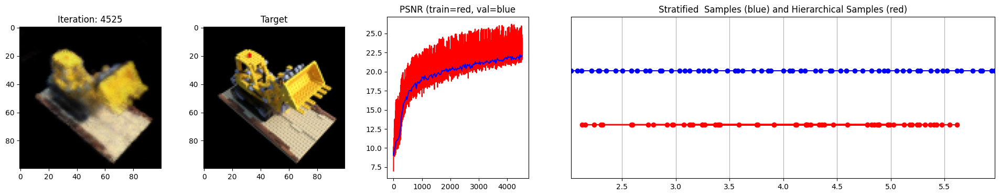

 91%|█████████ | 4550/5000 [35:56<03:12,  2.33it/s]

Loss: 0.006253805477172136


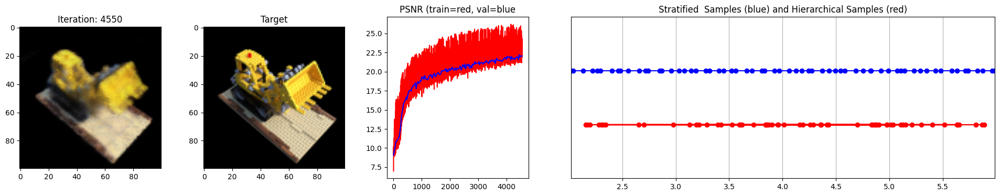

 92%|█████████▏| 4575/5000 [36:08<03:02,  2.33it/s]

Loss: 0.006162963807582855


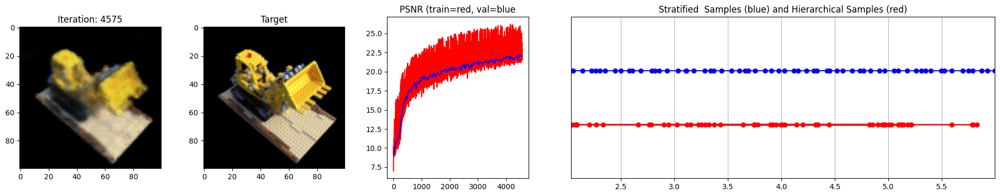

 92%|█████████▏| 4600/5000 [36:20<02:52,  2.32it/s]

Loss: 0.005777392536401749


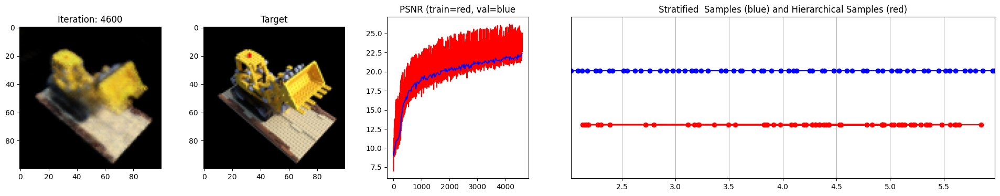

 92%|█████████▎| 4625/5000 [36:32<02:40,  2.33it/s]

Loss: 0.006257823668420315


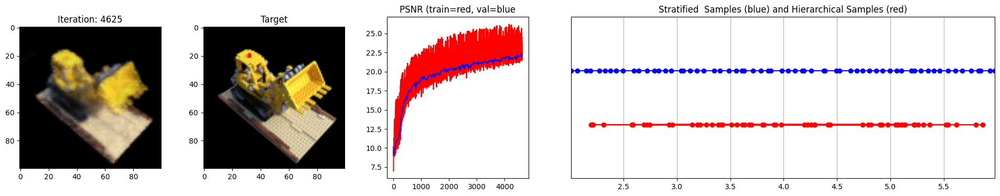

 93%|█████████▎| 4650/5000 [36:44<02:30,  2.33it/s]

Loss: 0.00600134301930666


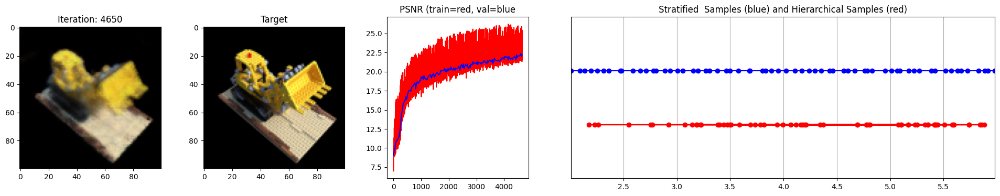

 94%|█████████▎| 4675/5000 [36:56<02:19,  2.33it/s]

Loss: 0.006119776051491499


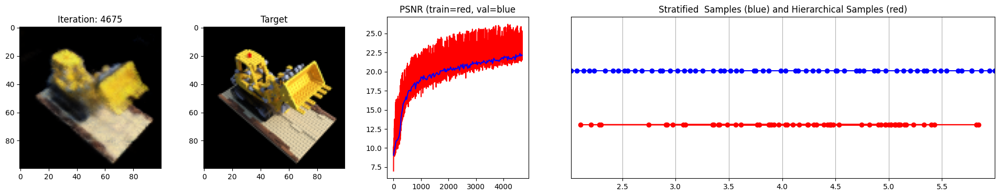

 94%|█████████▍| 4700/5000 [37:08<02:08,  2.34it/s]

Loss: 0.00667236652225256


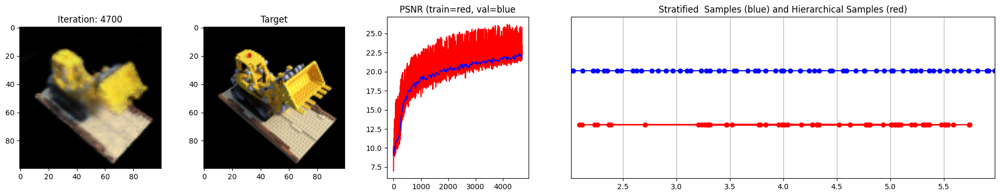

 94%|█████████▍| 4725/5000 [37:20<01:58,  2.33it/s]

Loss: 0.0064336336217820644


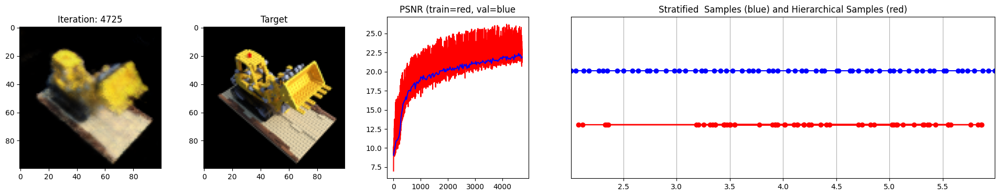

 95%|█████████▌| 4750/5000 [37:33<01:46,  2.34it/s]

Loss: 0.006381321232765913


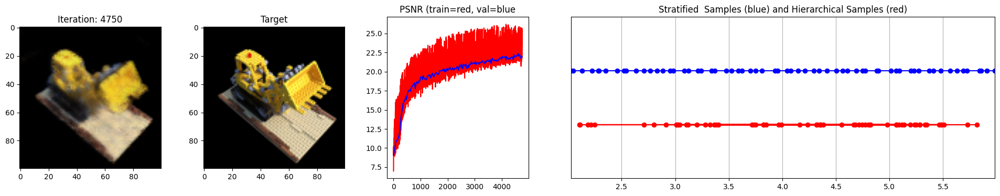

 96%|█████████▌| 4775/5000 [37:45<01:36,  2.34it/s]

Loss: 0.00627540098503232


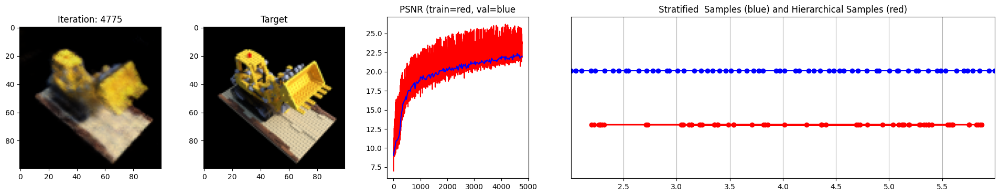

 96%|█████████▌| 4800/5000 [37:57<01:25,  2.33it/s]

Loss: 0.0055970484390854836


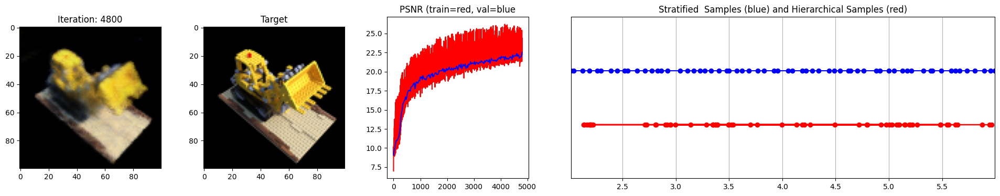

 96%|█████████▋| 4825/5000 [38:09<01:14,  2.35it/s]

Loss: 0.005850166082382202


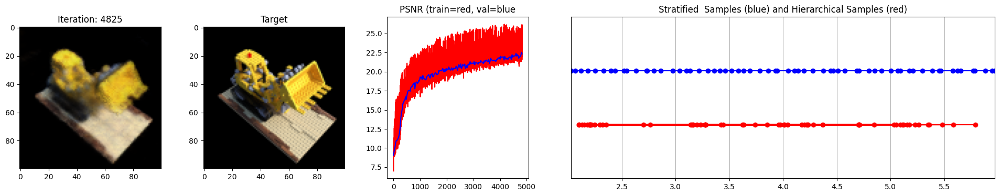

 97%|█████████▋| 4850/5000 [38:21<01:04,  2.33it/s]

Loss: 0.005537707358598709


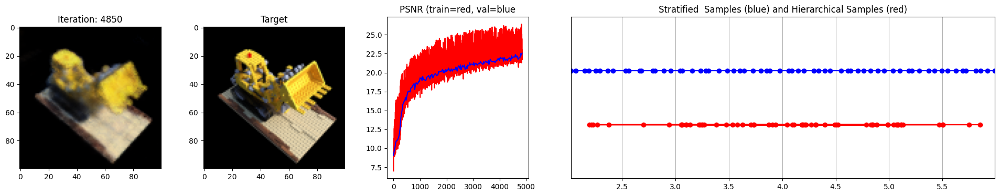

 98%|█████████▊| 4875/5000 [38:33<00:53,  2.32it/s]

Loss: 0.00599409407004714


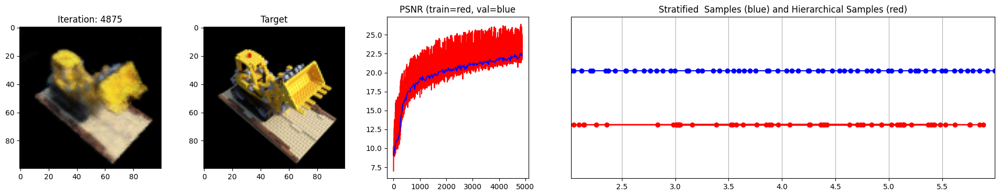

 98%|█████████▊| 4900/5000 [38:45<00:42,  2.34it/s]

Loss: 0.0058756377547979355


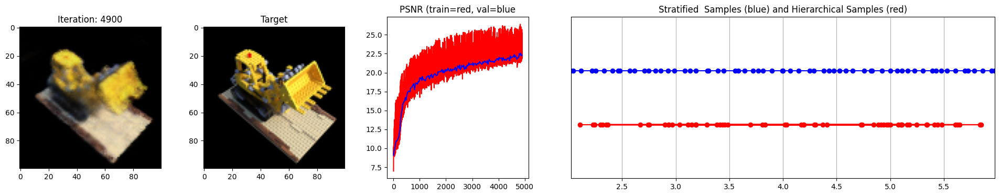

 98%|█████████▊| 4925/5000 [38:57<00:32,  2.33it/s]

Loss: 0.00609625456854701


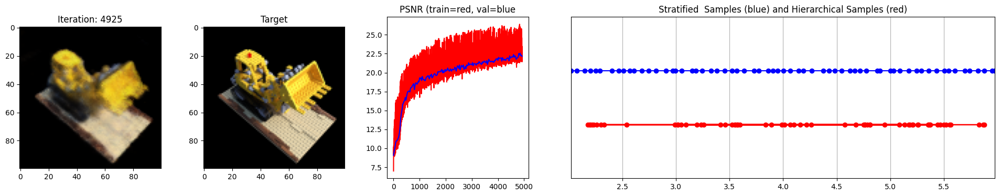

 99%|█████████▉| 4950/5000 [39:09<00:21,  2.34it/s]

Loss: 0.006059139035642147


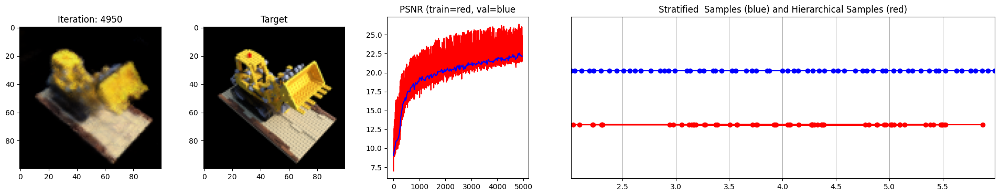

100%|█████████▉| 4975/5000 [39:21<00:10,  2.34it/s]

Loss: 0.006048377603292465


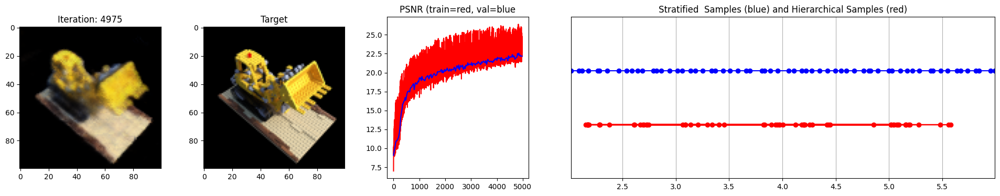

100%|██████████| 5000/5000 [39:33<00:00,  2.11it/s]

Training successful!

Done!


In [27]:
# Run training session(s)
for _ in range(n_restarts):
  model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()
  success, train_psnrs, val_psnrs = train()
  if success and val_psnrs[-1] >= warmup_min_fitness:
    print('Training successful!')
    break

print('')
print(f'Done!')

In [28]:
torch.save(model.state_dict(), '/content/drive/MyDrive/Colab_Notebooks/Spin_Nerf/Nerf/nerf.pt')
torch.save(fine_model.state_dict(), '/content/drive/MyDrive/Colab_Notebooks/Spin_Nerf/Nerf/nerf-fine.pt')